# Mi prier proyecto en vision computacional


In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


El tamaño de la imagen es: (2304, 3072, 3)


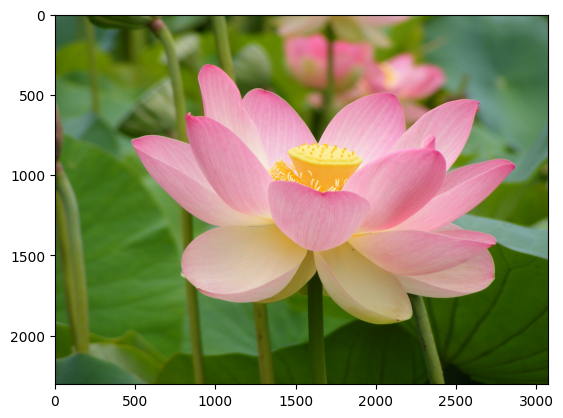

In [5]:
bgr = cv2.imread('imagen.jpg')
print("El tamaño de la imagen es:", bgr.shape)
rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
plt.imshow(rgb)


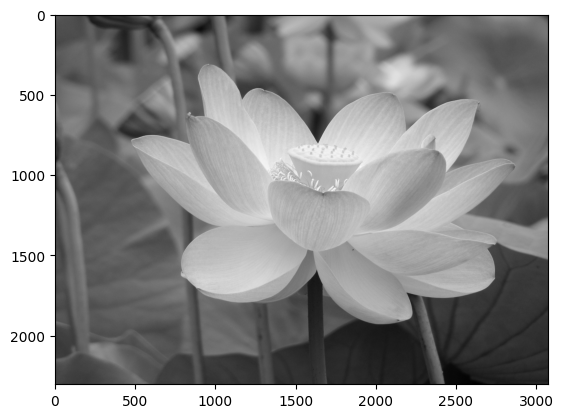

In [6]:
gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY)
plt.imshow(gray, cmap='gray')

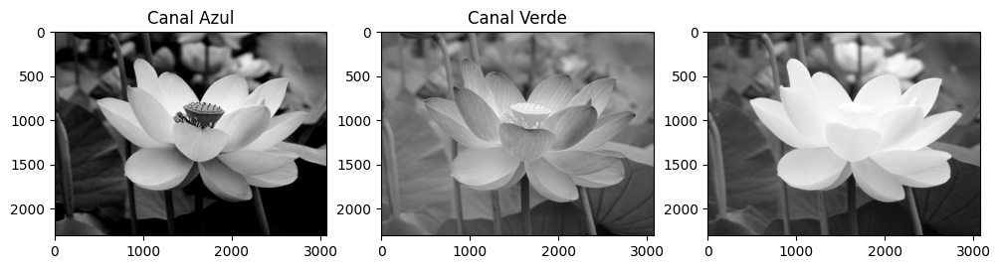

In [8]:
# Mostrar los componentes de color de la imagen
b, g, r = cv2.split(bgr)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(b, cmap='gray')
plt.title('Canal Azul')
plt.subplot(1,3,2)
plt.imshow(g, cmap='gray')
plt.title('Canal Verde')
plt.subplot(1,3,3)
plt.imshow(r, cmap='gray')


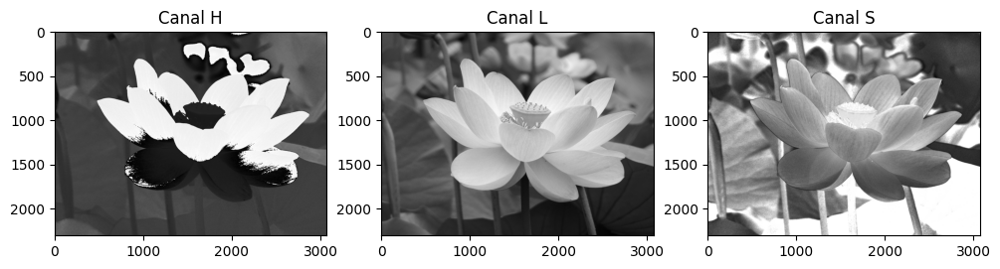

In [9]:
# Mostrar los componentes HLKS de la imagen
hls = cv2.cvtColor(bgr, cv2.COLOR_BGR2HLS)
h, l, s = cv2.split(hls)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(h, cmap='gray')
plt.title('Canal H')
plt.subplot(1,3,2)
plt.imshow(l, cmap='gray')
plt.title('Canal L')
plt.subplot(1,3,3)
plt.imshow(s, cmap='gray')
plt.title('Canal S')
plt.show()

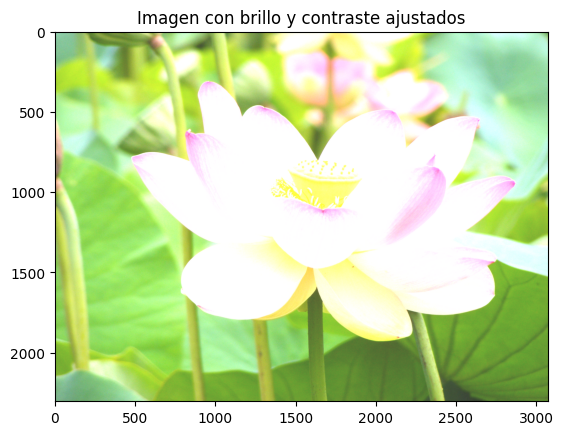

In [10]:
# Ajuste de brillo y contraste
alpha = 1.5  # Contraste
beta = 50    # Brillo
adjusted = cv2.convertScaleAbs(bgr, alpha=alpha, beta=beta)
adjusted_rgb = cv2.cvtColor(adjusted, cv2.COLOR_BGR2RGB)
plt.imshow(adjusted_rgb)
plt.title('Imagen con brillo y contraste ajustados')
plt.show()

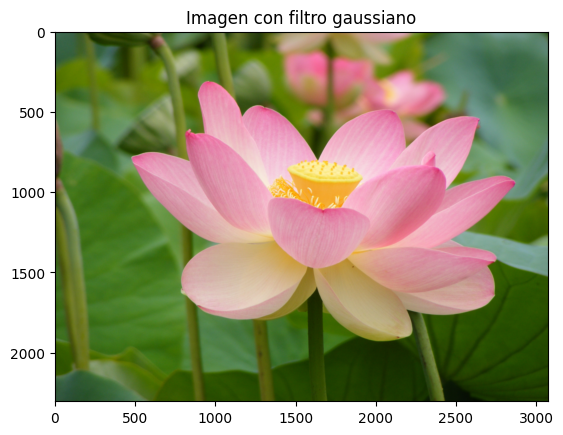

In [12]:
# Aplicar filtro gaussiano
blurred = cv2.GaussianBlur(bgr, (7, 7), 0)
blurred_rgb = cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_rgb)
plt.title('Imagen con filtro gaussiano')
plt.show()

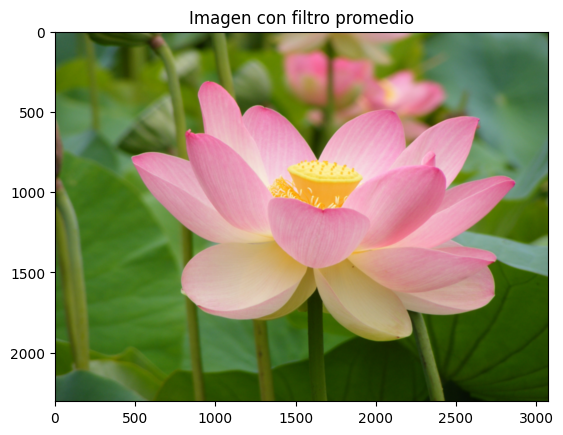

In [14]:
# Aplicar filtro promedio
kernel_size = (7, 7)
blurred_avg = cv2.blur(bgr, kernel_size)
blurred_avg_rgb = cv2.cvtColor(blurred_avg, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_avg_rgb)
plt.title('Imagen con filtro promedio')
plt.show()

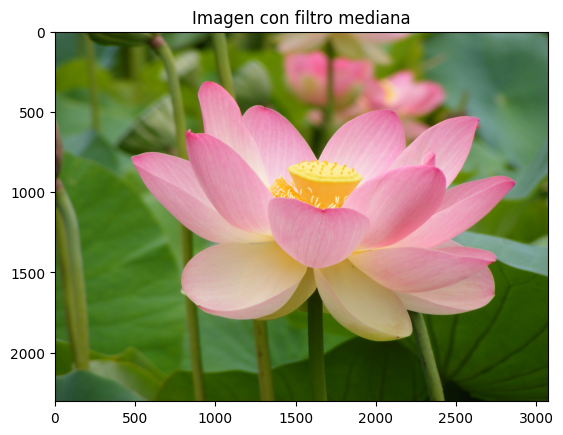

In [15]:
# Aplicar filtro mediana
blurred_median = cv2.medianBlur(bgr, 7)
blurred_median_rgb = cv2.cvtColor(blurred_median, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_median_rgb)
plt.title('Imagen con filtro mediana')
plt.show()

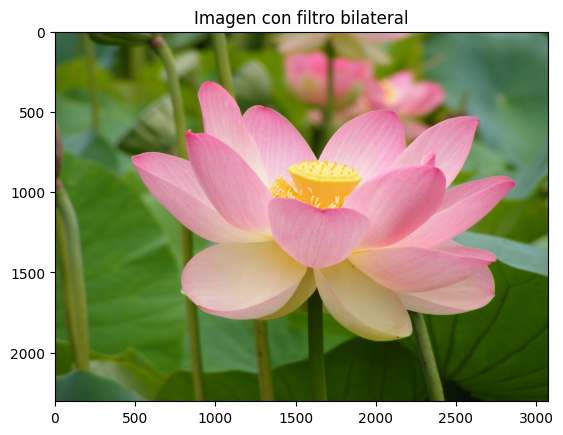

In [16]:
# Aplicar filtro bilateral
blurred_bilateral = cv2.bilateralFilter(bgr, 9, 75, 75)
blurred_bilateral_rgb = cv2.cvtColor(blurred_bilateral, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_bilateral_rgb)
plt.title('Imagen con filtro bilateral')
plt.show()

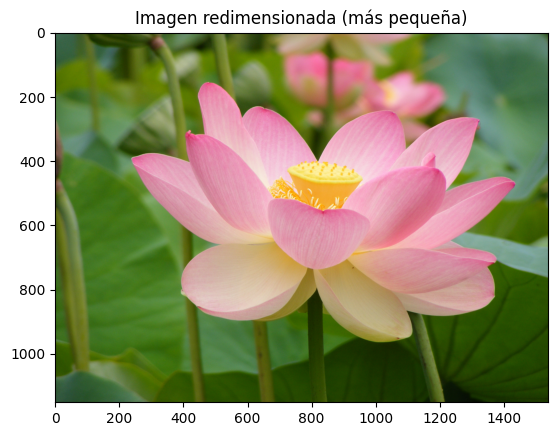

In [17]:
# Transformacion geometrica: Redimensionamiento (mas pequeña)
bgr_small = cv2.resize(bgr, (0, 0), fx=0.5, fy=0.5)
bgr_small_rgb = cv2.cvtColor(bgr_small, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_small_rgb)
plt.title('Imagen redimensionada (más pequeña)')
plt.show()

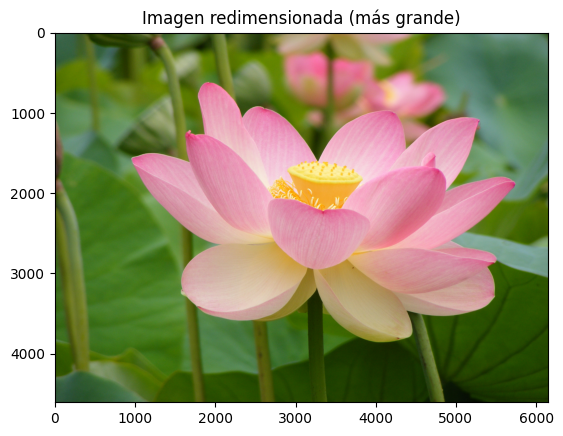

In [18]:
# Transformacion geometrica: Redimensionamiento (mas grande)
bgr_large = cv2.resize(bgr, (0, 0), fx=2, fy=2)
bgr_large_rgb = cv2.cvtColor(bgr_large, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_large_rgb)
plt.title('Imagen redimensionada (más grande)')
plt.show()

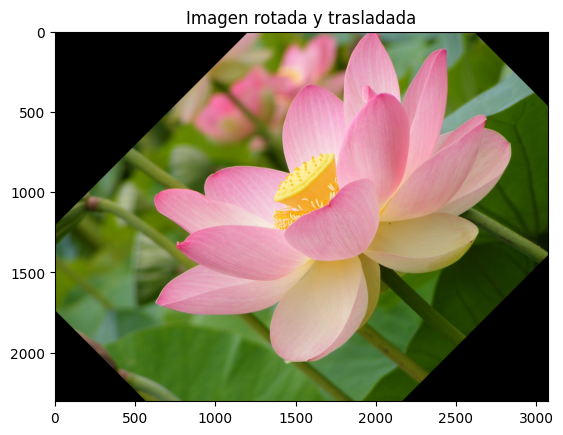

In [21]:
# Transformacion geometrica: Rotacion y transklacion
(h, w) = bgr.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, 45, 1.0)
M[0, 2] += 100  # Desplazamiento en x
M[1, 2] += 50   # Desplazamiento en y
bgr_transformed = cv2.warpAffine(bgr, M, (w, h))
bgr_transformed_rgb = cv2.cvtColor(bgr_transformed, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_transformed_rgb)
plt.title('Imagen rotada y trasladada')
plt.show()

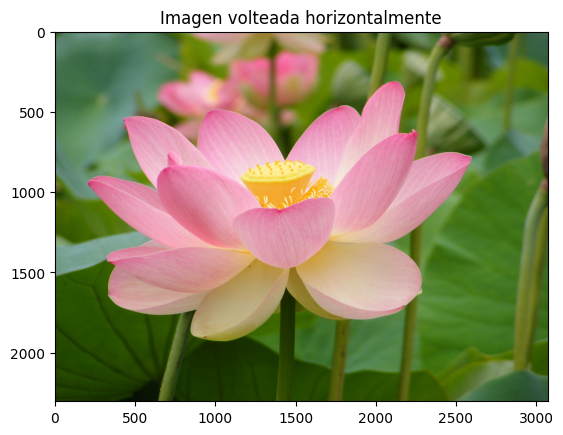

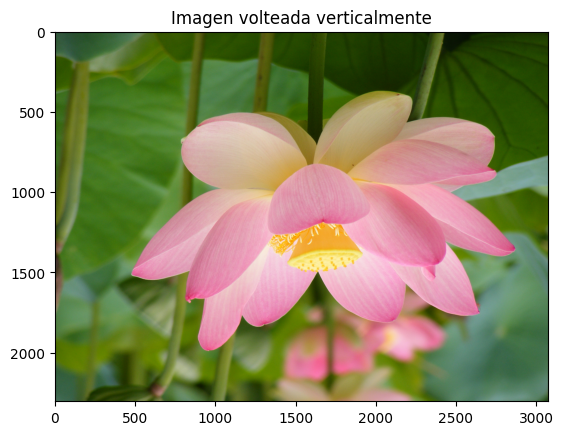

In [22]:
# Transformacion geometrica: Volteo horizontal y vertical
bgr_flipped_h = cv2.flip(bgr, 1)
bgr_flipped_h_rgb = cv2.cvtColor(bgr_flipped_h, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_h_rgb)
plt.title('Imagen volteada horizontalmente')
plt.show()

bgr_flipped_v = cv2.flip(bgr, 0)
bgr_flipped_v_rgb = cv2.cvtColor(bgr_flipped_v, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_v_rgb)
plt.title('Imagen volteada verticalmente')
plt.show()

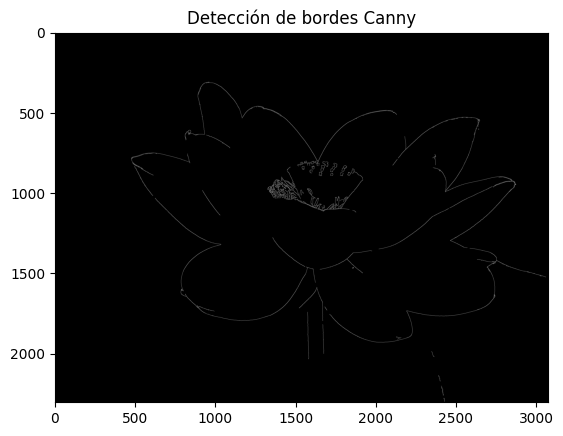

In [23]:
# Aplicar detencion de bordes Canny
edges = cv2.Canny(bgr, 100, 200)
plt.imshow(edges, cmap='gray')
plt.title('Detección de bordes Canny')
plt.show()

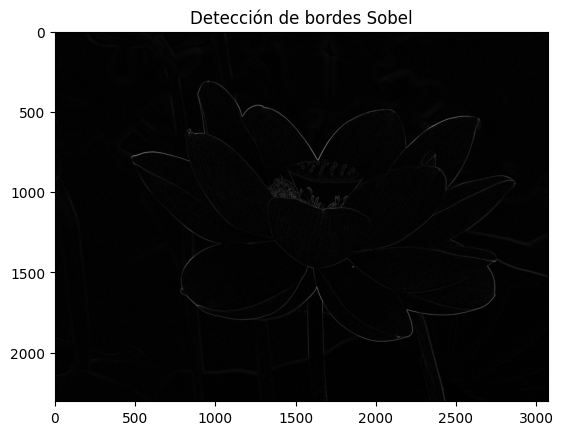

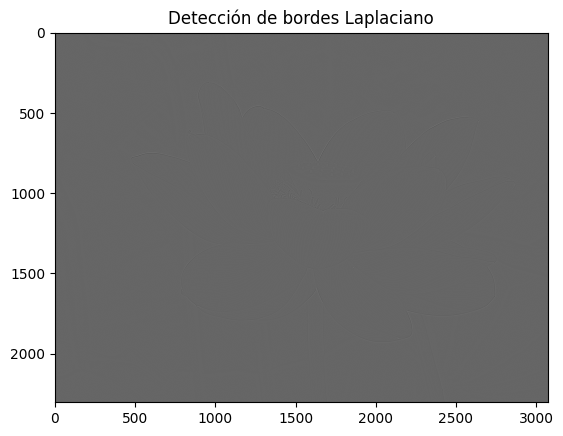

In [25]:
# Aplicar analisis de bordes Sobel y Laplaciano
sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
sobel_combined = cv2.magnitude(sobel_x, sobel_y)
plt.imshow(sobel_combined, cmap='gray')
plt.title('Detección de bordes Sobel')
plt.show()

laplacian = cv2.Laplacian(gray, cv2.CV_64F)
plt.imshow(laplacian, cmap='gray')
plt.title('Detección de bordes Laplaciano')
plt.show()

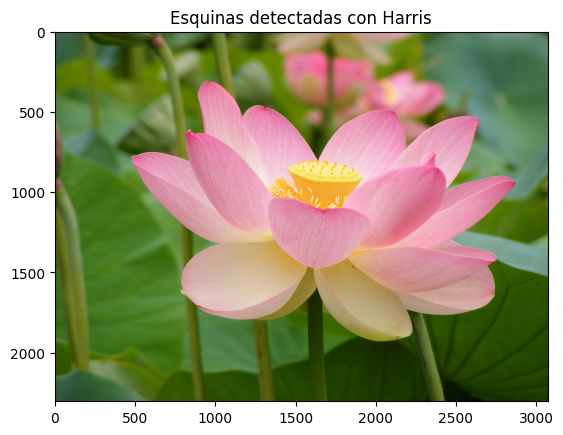

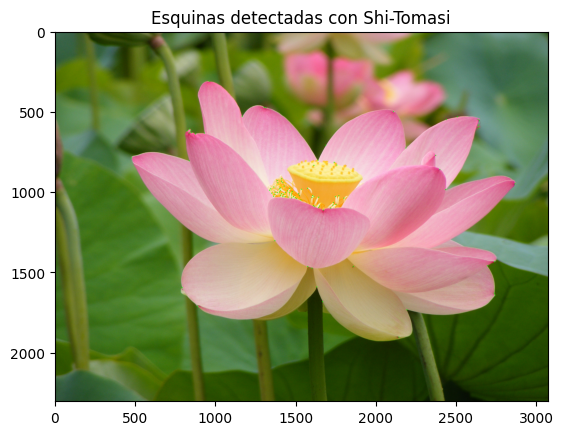

In [ ]:
# Aplicar metodos de detencion de esquinas Harris y Shi-Tomasi
gray_float = np.float32(gray)
harris_corners = cv2.cornerHarris(gray_float, 2, 3, 0.04)
harris_corners = cv2.dilate(harris_corners, None)
bgr_harris = bgr.copy()
bgr_harris[harris_corners > 0.01 * harris_corners.max()] = [0, 0, 255]
bgr_harris_rgb = cv2.cvtColor(bgr_harris, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_harris_rgb)
plt.title('Esquinas detectadas con Harris')
plt.show()
shi_corners = cv2.goodFeaturesToTrack(gray, 100, 0.01, 10)
shi_corners = np.int0(shi_corners)
bgr_shi = bgr.copy()
for corner in shi_corners:
    x, y = corner.ravel()
    cv2.circle(bgr_shi, (x, y), 3, (0, 255, 0), -1)
bgr_shi_rgb = cv2.cvtColor(bgr_shi, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_shi_rgb)
plt.title('Esquinas detectadas con Shi-Tomasi')
plt.show()

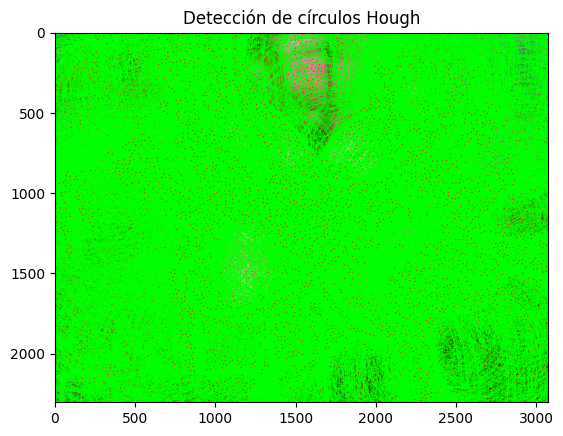

In [29]:
# Aplicar deteccion de formas HoughCircles
circles = cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT, dp=1, minDist=20,
                           param1=50, param2=30, minRadius=0, maxRadius=0)
bgr_circles = bgr.copy()
if circles is not None:
    circles = np.uint16(np.around(circles))
    for i in circles[0, :]:
        cv2.circle(bgr_circles, (i[0], i[1]), i[2], (0, 255, 0), 2)
        cv2.circle(bgr_circles, (i[0], i[1]), 2, (0, 0, 255), 3)
bgr_circles_rgb = cv2.cvtColor(bgr_circles, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_circles_rgb)
plt.title('Detección de círculos Hough')
plt.show()

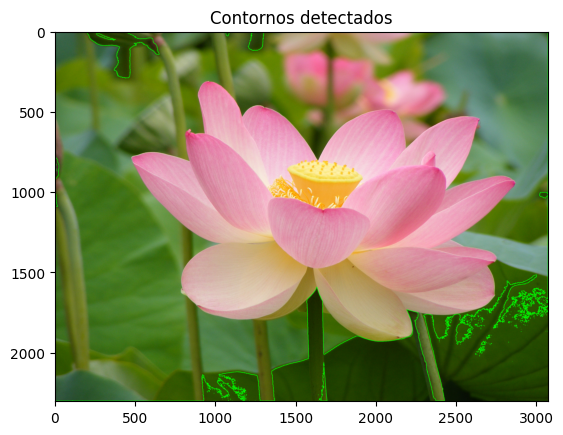

In [30]:
# Aplicar deccion de formas: contornos principales del objeto en la imagen
gray_blurred = cv2.GaussianBlur(gray, (5, 5), 0)
_, thresh = cv2.threshold(gray_blurred, 60, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
bgr_contours = bgr.copy()
cv2.drawContours(bgr_contours, contours, -1, (0, 255, 0), 2)
bgr_contours_rgb = cv2.cvtColor(bgr_contours, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_contours_rgb)
plt.title('Contornos detectados')
plt.show()

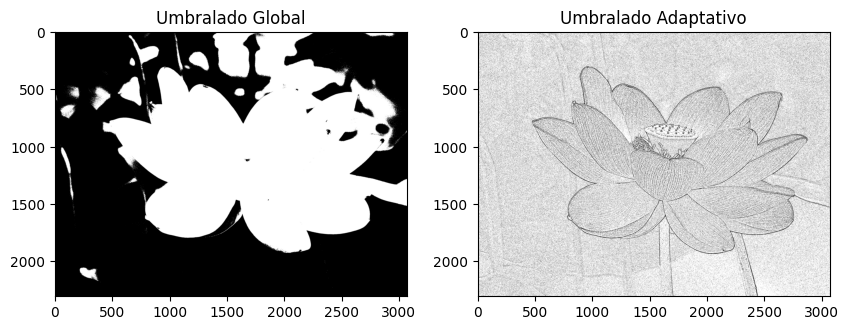

In [31]:
# Aplicar segmentacion de objeto: Umbralado (global y adaptativo)
_, global_thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 11, 2)
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(global_thresh, cmap='gray')
plt.title('Umbralado Global')
plt.subplot(1,2,2)
plt.imshow(adaptive_thresh, cmap='gray')
plt.title('Umbralado Adaptativo')
plt.show()


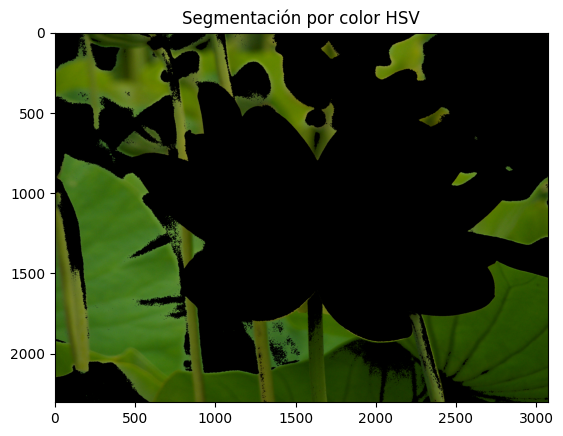

In [32]:
# Aplicar segmentacion de objeto: por color HSV
hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
lower_color = np.array([30, 150, 50])
upper_color = np.array([85, 255, 255])
mask = cv2.inRange(hsv, lower_color, upper_color)
result = cv2.bitwise_and(bgr, bgr, mask=mask)
result_rgb = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
plt.imshow(result_rgb)
plt.title('Segmentación por color HSV')
plt.show()

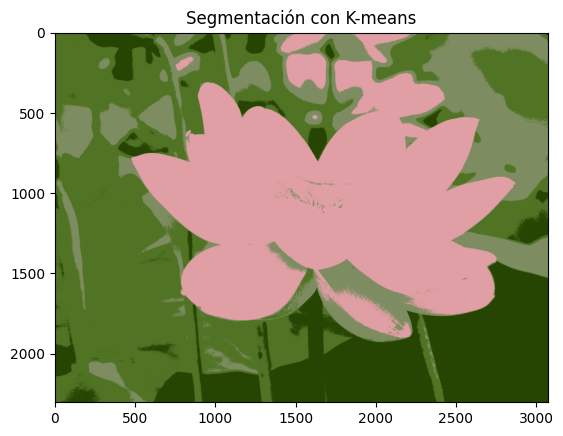

In [33]:
# Aplicar segmentacion de objeto: K-means clustering
Z = bgr.reshape((-1, 3))
Z = np.float32(Z)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
K = 4
_, labels, centers = cv2.kmeans(Z, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
centers = np.uint8(centers)
segmented_data = centers[labels.flatten()]
segmented_image = segmented_data.reshape((bgr.shape))
segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)
plt.imshow(segmented_image_rgb)
plt.title('Segmentación con K-means')
plt.show()

El tamaño de la imagen es: (675, 1200, 3)


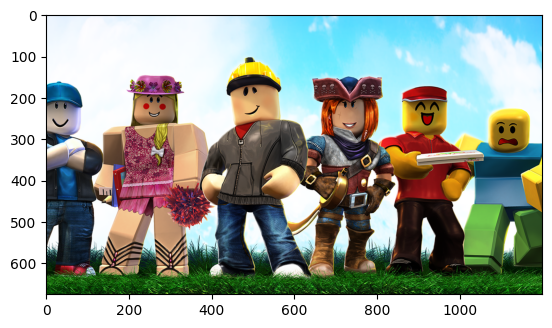

In [34]:
bgr = cv2.imread('imagen 2.webp')
print("El tamaño de la imagen es:", bgr.shape)
rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
plt.imshow(rgb)

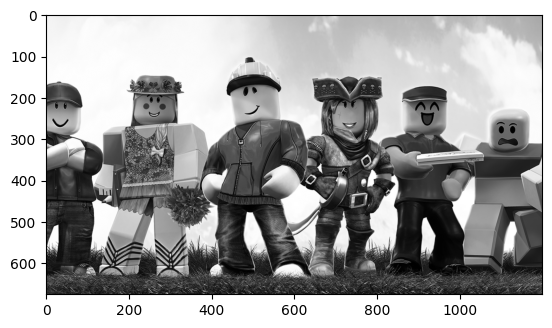

In [35]:
gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY)
plt.imshow(gray, cmap='gray')

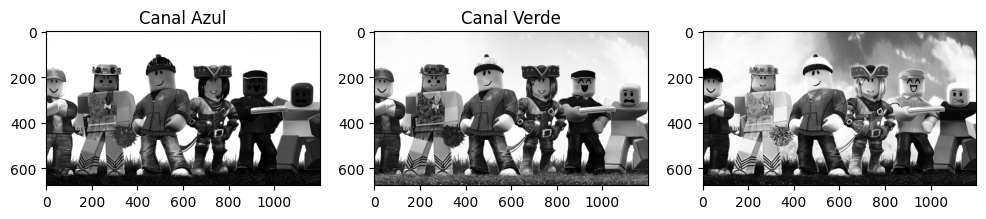

In [36]:
# Mostrar los componentes de color de la imagen
b, g, r = cv2.split(bgr)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(b, cmap='gray')
plt.title('Canal Azul')
plt.subplot(1,3,2)
plt.imshow(g, cmap='gray')
plt.title('Canal Verde')
plt.subplot(1,3,3)
plt.imshow(r, cmap='gray')

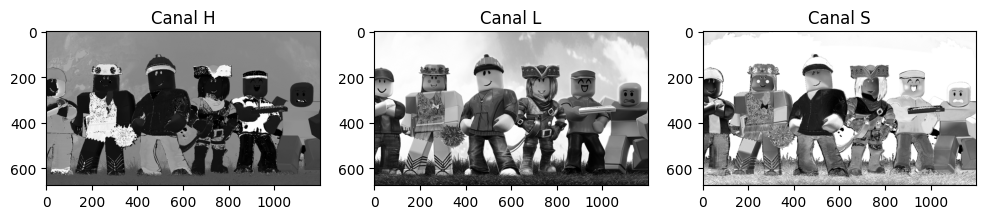

In [37]:
# Mostrar los componentes HLKS de la imagen
hls = cv2.cvtColor(bgr, cv2.COLOR_BGR2HLS)
h, l, s = cv2.split(hls)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(h, cmap='gray')
plt.title('Canal H')
plt.subplot(1,3,2)
plt.imshow(l, cmap='gray')
plt.title('Canal L')
plt.subplot(1,3,3)
plt.imshow(s, cmap='gray')
plt.title('Canal S')
plt.show()

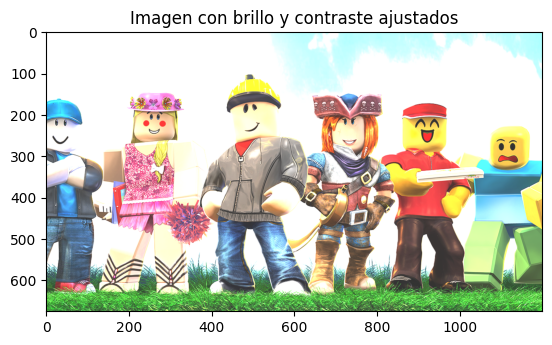

In [38]:
# Ajuste de brillo y contraste
alpha = 1.5  # Contraste
beta = 50    # Brillo
adjusted = cv2.convertScaleAbs(bgr, alpha=alpha, beta=beta)
adjusted_rgb = cv2.cvtColor(adjusted, cv2.COLOR_BGR2RGB)
plt.imshow(adjusted_rgb)
plt.title('Imagen con brillo y contraste ajustados')
plt.show()

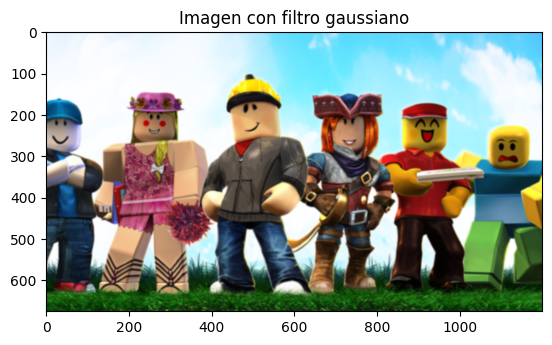

In [39]:
# Aplicar filtro gaussiano
blurred = cv2.GaussianBlur(bgr, (7, 7), 0)
blurred_rgb = cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_rgb)
plt.title('Imagen con filtro gaussiano')
plt.show()

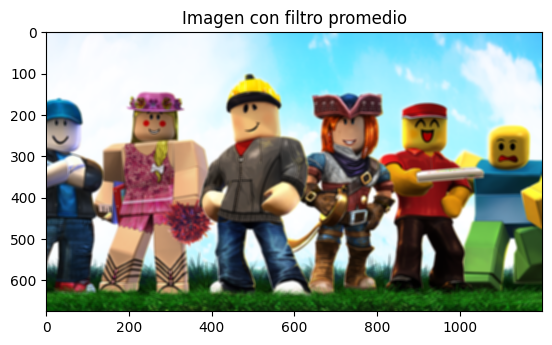

In [40]:
# Aplicar filtro promedio
kernel_size = (7, 7)
blurred_avg = cv2.blur(bgr, kernel_size)
blurred_avg_rgb = cv2.cvtColor(blurred_avg, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_avg_rgb)
plt.title('Imagen con filtro promedio')
plt.show()

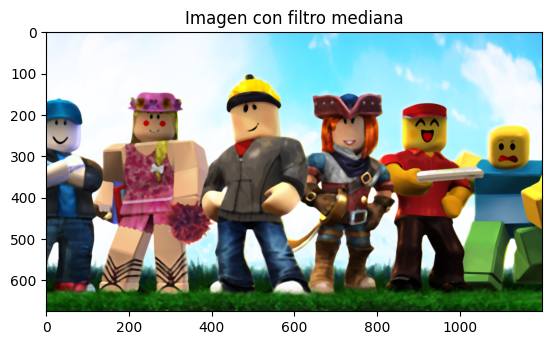

In [41]:
# Aplicar filtro mediana
blurred_median = cv2.medianBlur(bgr, 7)
blurred_median_rgb = cv2.cvtColor(blurred_median, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_median_rgb)
plt.title('Imagen con filtro mediana')
plt.show()

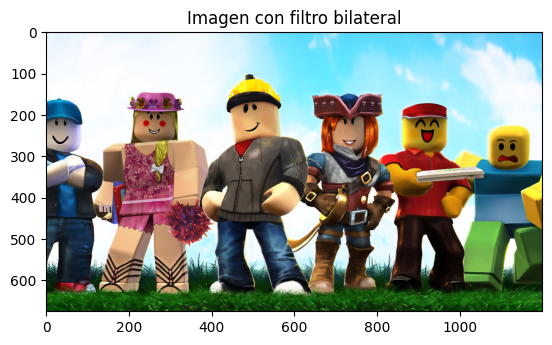

In [42]:
# Aplicar filtro bilateral
blurred_bilateral = cv2.bilateralFilter(bgr, 9, 75, 75)
blurred_bilateral_rgb = cv2.cvtColor(blurred_bilateral, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_bilateral_rgb)
plt.title('Imagen con filtro bilateral')
plt.show()

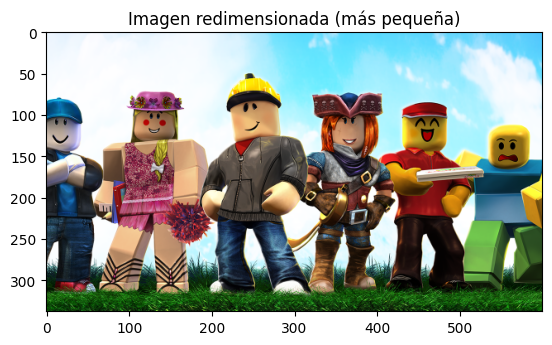

In [43]:
# Transformacion geometrica: Redimensionamiento (mas pequeña)
bgr_small = cv2.resize(bgr, (0, 0), fx=0.5, fy=0.5)
bgr_small_rgb = cv2.cvtColor(bgr_small, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_small_rgb)
plt.title('Imagen redimensionada (más pequeña)')
plt.show()

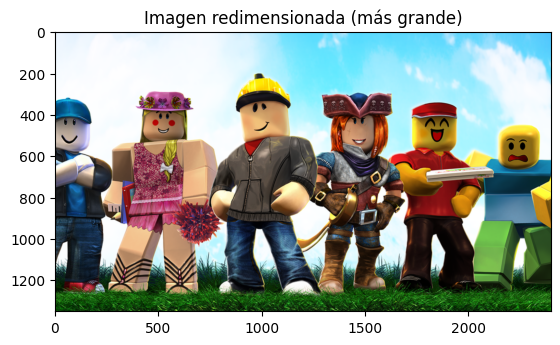

In [44]:
# Transformacion geometrica: Redimensionamiento (mas grande)
bgr_large = cv2.resize(bgr, (0, 0), fx=2, fy=2)
bgr_large_rgb = cv2.cvtColor(bgr_large, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_large_rgb)
plt.title('Imagen redimensionada (más grande)')
plt.show()

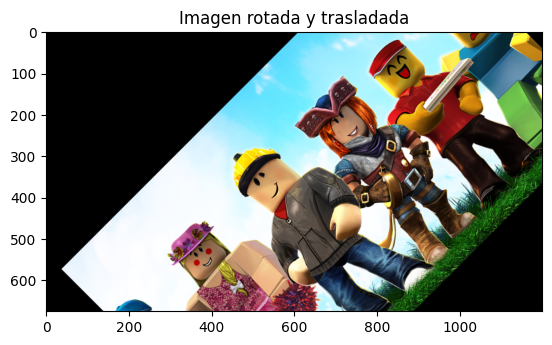

In [ ]:
# Transformacion geometrica: Rotacion y translacion
(h, w) = bgr.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, 45, 1.0)
M[0, 2] += 100  # Desplazamiento en x
M[1, 2] += 50   # Desplazamiento en y
bgr_transformed = cv2.warpAffine(bgr, M, (w, h))
bgr_transformed_rgb = cv2.cvtColor(bgr_transformed, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_transformed_rgb)
plt.title('Imagen rotada y trasladada')
plt.show()

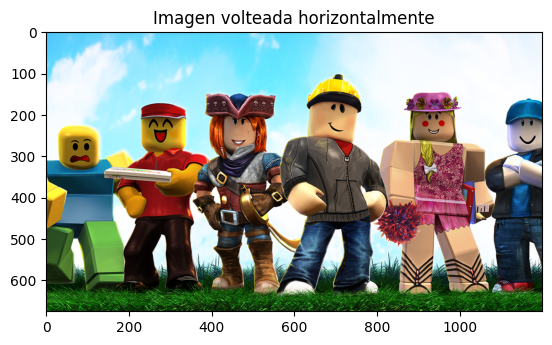

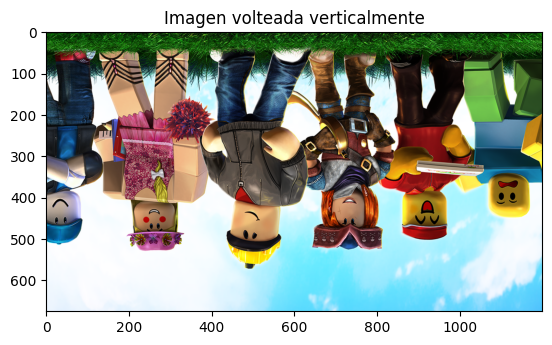

In [46]:
# Transformacion geometrica: Volteo horizontal y vertical
bgr_flipped_h = cv2.flip(bgr, 1)
bgr_flipped_h_rgb = cv2.cvtColor(bgr_flipped_h, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_h_rgb)
plt.title('Imagen volteada horizontalmente')
plt.show()

bgr_flipped_v = cv2.flip(bgr, 0)
bgr_flipped_v_rgb = cv2.cvtColor(bgr_flipped_v, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_v_rgb)
plt.title('Imagen volteada verticalmente')
plt.show()

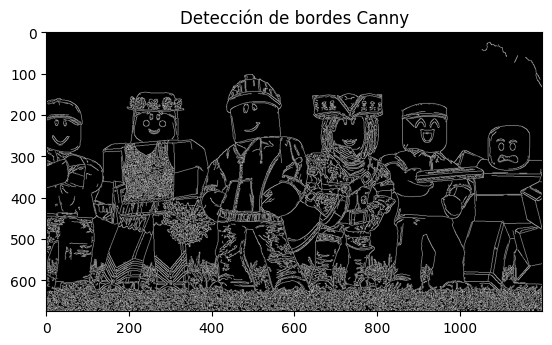

In [47]:
# Aplicar detencion de bordes Canny
edges = cv2.Canny(bgr, 100, 200)
plt.imshow(edges, cmap='gray')
plt.title('Detección de bordes Canny')
plt.show()

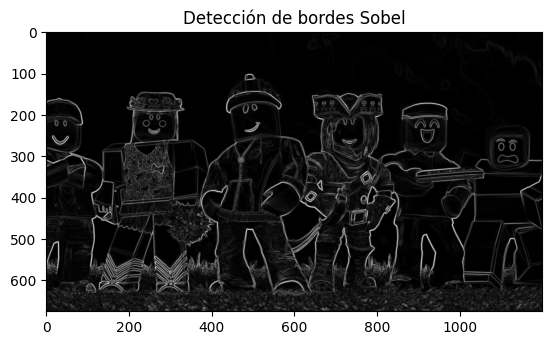

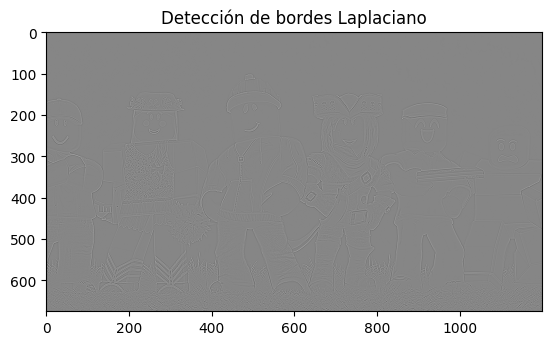

In [48]:
# Aplicar analisis de bordes Sobel y Laplaciano
sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
sobel_combined = cv2.magnitude(sobel_x, sobel_y)
plt.imshow(sobel_combined, cmap='gray')
plt.title('Detección de bordes Sobel')
plt.show()

laplacian = cv2.Laplacian(gray, cv2.CV_64F)
plt.imshow(laplacian, cmap='gray')
plt.title('Detección de bordes Laplaciano')
plt.show()

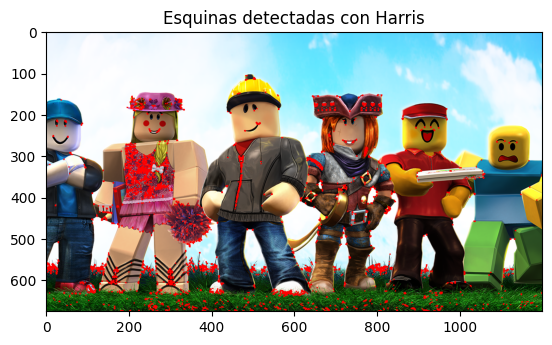

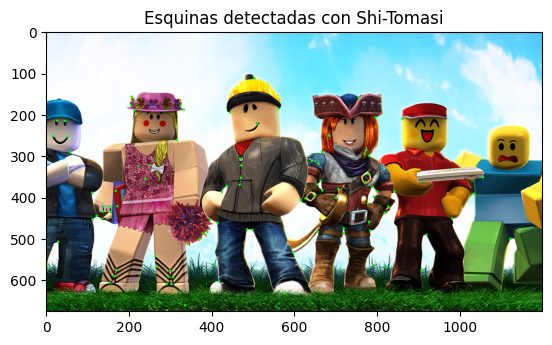

In [50]:
# Aplicar metodos de detencion de esquinas Harris y Shi-Tomasi
gray_float = np.float32(gray)
harris_corners = cv2.cornerHarris(gray_float, 2, 3, 0.04)
harris_corners = cv2.dilate(harris_corners, None)
bgr_harris = bgr.copy()
bgr_harris[harris_corners > 0.01 * harris_corners.max()] = [0, 0, 255]
bgr_harris_rgb = cv2.cvtColor(bgr_harris, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_harris_rgb)
plt.title('Esquinas detectadas con Harris')
plt.show()
shi_corners = cv2.goodFeaturesToTrack(gray, 100, 0.01, 10)
shi_corners = shi_corners.astype(int)
bgr_shi = bgr.copy()
for corner in shi_corners:
    x, y = corner.ravel()
    cv2.circle(bgr_shi, (x, y), 3, (0, 255, 0), -1)
bgr_shi_rgb = cv2.cvtColor(bgr_shi, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_shi_rgb)
plt.title('Esquinas detectadas con Shi-Tomasi')
plt.show()

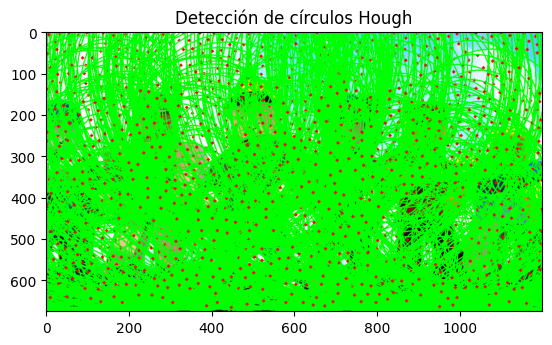

In [51]:
# Aplicar deteccion de formas HoughCircles
circles = cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT, dp=1, minDist=20,
                           param1=50, param2=30, minRadius=0, maxRadius=0)
bgr_circles = bgr.copy()
if circles is not None:
    circles = np.uint16(np.around(circles))
    for i in circles[0, :]:
        cv2.circle(bgr_circles, (i[0], i[1]), i[2], (0, 255, 0), 2)
        cv2.circle(bgr_circles, (i[0], i[1]), 2, (0, 0, 255), 3)
bgr_circles_rgb = cv2.cvtColor(bgr_circles, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_circles_rgb)
plt.title('Detección de círculos Hough')
plt.show()

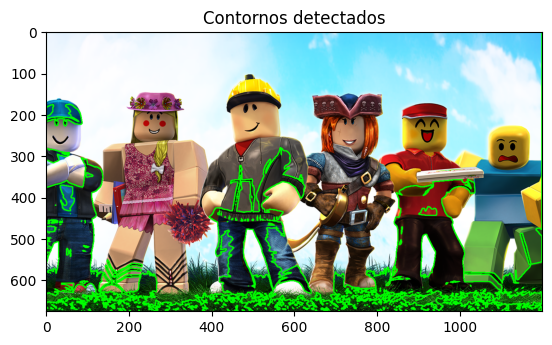

In [52]:
# Aplicar deccion de formas: contornos principales del objeto en la imagen
gray_blurred = cv2.GaussianBlur(gray, (5, 5), 0)
_, thresh = cv2.threshold(gray_blurred, 60, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
bgr_contours = bgr.copy()
cv2.drawContours(bgr_contours, contours, -1, (0, 255, 0), 2)
bgr_contours_rgb = cv2.cvtColor(bgr_contours, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_contours_rgb)
plt.title('Contornos detectados')
plt.show()

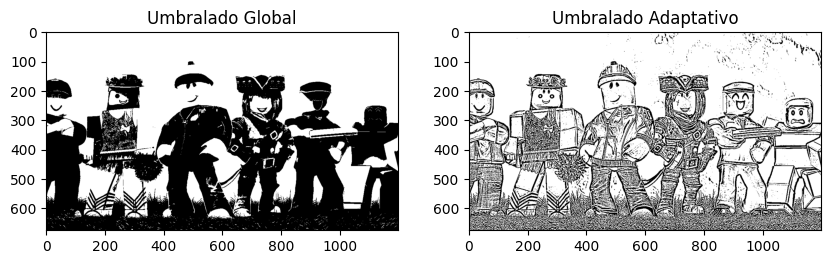

In [53]:
# Aplicar segmentacion de objeto: Umbralado (global y adaptativo)
_, global_thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 11, 2)
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(global_thresh, cmap='gray')
plt.title('Umbralado Global')
plt.subplot(1,2,2)
plt.imshow(adaptive_thresh, cmap='gray')
plt.title('Umbralado Adaptativo')
plt.show()

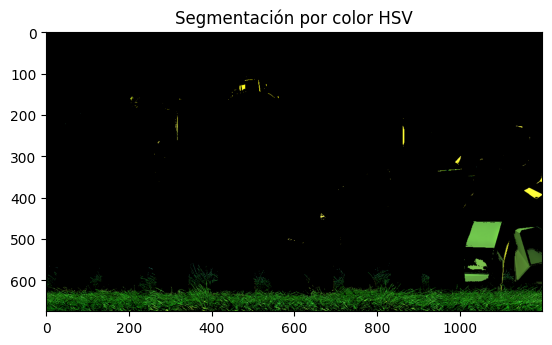

In [54]:
# Aplicar segmentacion de objeto: por color HSV
hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
lower_color = np.array([30, 150, 50])
upper_color = np.array([85, 255, 255])
mask = cv2.inRange(hsv, lower_color, upper_color)
result = cv2.bitwise_and(bgr, bgr, mask=mask)
result_rgb = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
plt.imshow(result_rgb)
plt.title('Segmentación por color HSV')
plt.show()

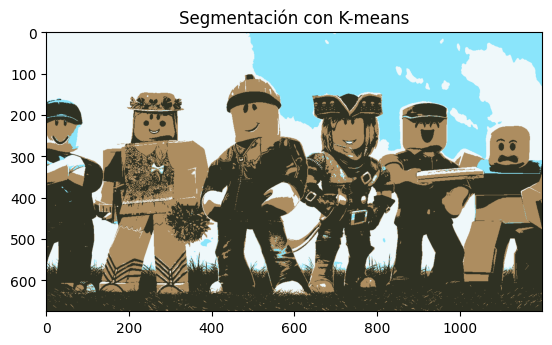

In [55]:
# Aplicar segmentacion de objeto: K-means clustering
Z = bgr.reshape((-1, 3))
Z = np.float32(Z)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
K = 4
_, labels, centers = cv2.kmeans(Z, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
centers = np.uint8(centers)
segmented_data = centers[labels.flatten()]
segmented_image = segmented_data.reshape((bgr.shape))
segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)
plt.imshow(segmented_image_rgb)
plt.title('Segmentación con K-means')
plt.show()

El tamaño de la imagen es: (621, 828, 3)


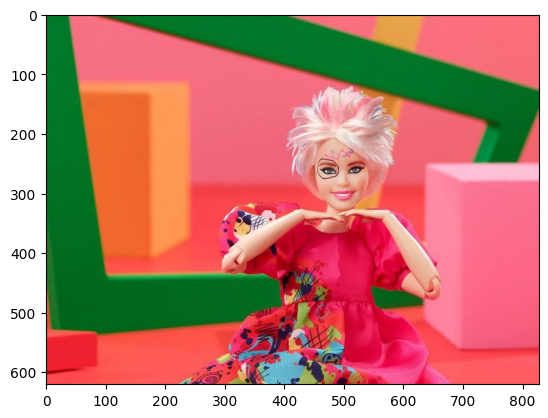

In [61]:
bgr = cv2.imread('imagen 3.jpg')
print("El tamaño de la imagen es:", bgr.shape)
rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
plt.imshow(rgb)

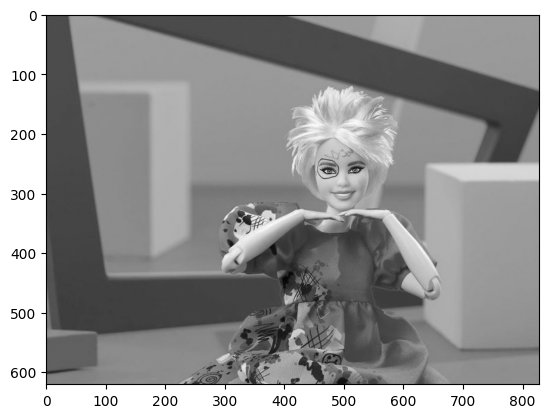

In [62]:
gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY)
plt.imshow(gray, cmap='gray')

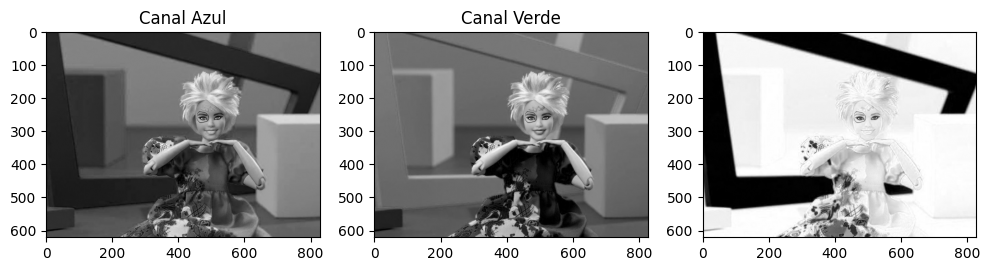

In [63]:
# Mostrar los componentes de color de la imagen
b, g, r = cv2.split(bgr)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(b, cmap='gray')
plt.title('Canal Azul')
plt.subplot(1,3,2)
plt.imshow(g, cmap='gray')
plt.title('Canal Verde')
plt.subplot(1,3,3)
plt.imshow(r, cmap='gray')

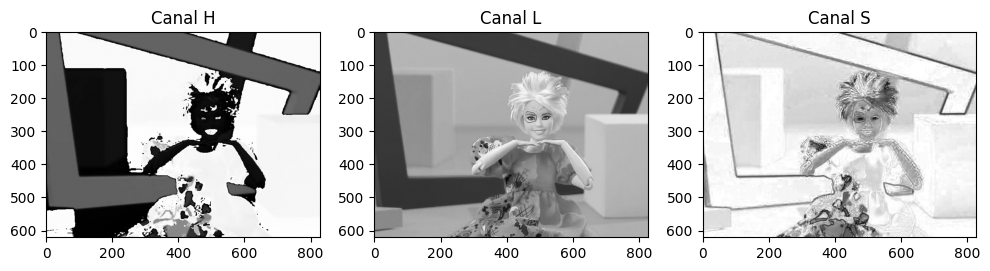

In [64]:
# Mostrar los componentes HLKS de la imagen
hls = cv2.cvtColor(bgr, cv2.COLOR_BGR2HLS)
h, l, s = cv2.split(hls)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(h, cmap='gray')
plt.title('Canal H')
plt.subplot(1,3,2)
plt.imshow(l, cmap='gray')
plt.title('Canal L')
plt.subplot(1,3,3)
plt.imshow(s, cmap='gray')
plt.title('Canal S')
plt.show()

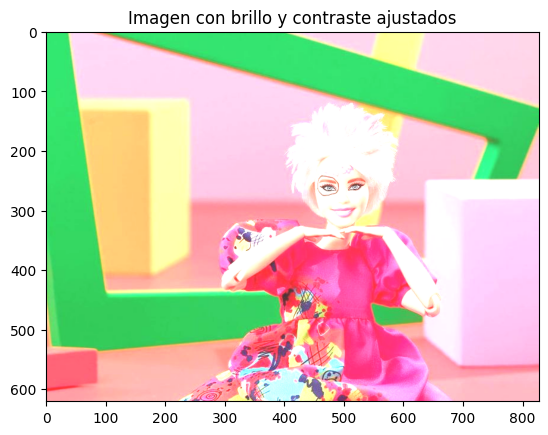

In [65]:
# Ajuste de brillo y contraste
alpha = 1.5  # Contraste
beta = 50    # Brillo
adjusted = cv2.convertScaleAbs(bgr, alpha=alpha, beta=beta)
adjusted_rgb = cv2.cvtColor(adjusted, cv2.COLOR_BGR2RGB)
plt.imshow(adjusted_rgb)
plt.title('Imagen con brillo y contraste ajustados')
plt.show()

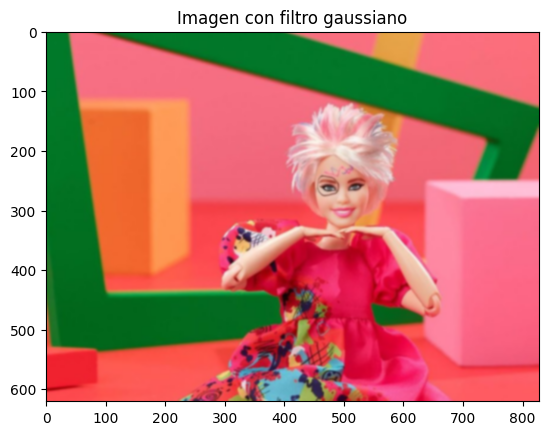

In [66]:
# Aplicar filtro gaussiano
blurred = cv2.GaussianBlur(bgr, (7, 7), 0)
blurred_rgb = cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_rgb)
plt.title('Imagen con filtro gaussiano')
plt.show()

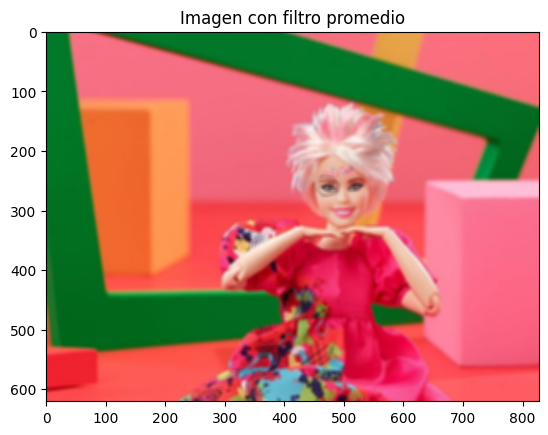

In [67]:
# Aplicar filtro promedio
kernel_size = (7, 7)
blurred_avg = cv2.blur(bgr, kernel_size)
blurred_avg_rgb = cv2.cvtColor(blurred_avg, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_avg_rgb)
plt.title('Imagen con filtro promedio')
plt.show()

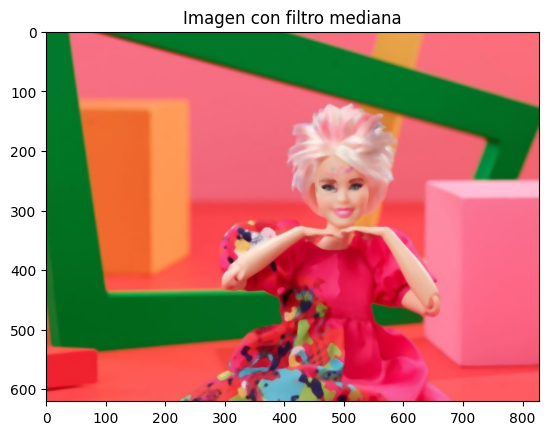

In [68]:
# Aplicar filtro mediana
blurred_median = cv2.medianBlur(bgr, 7)
blurred_median_rgb = cv2.cvtColor(blurred_median, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_median_rgb)
plt.title('Imagen con filtro mediana')
plt.show()

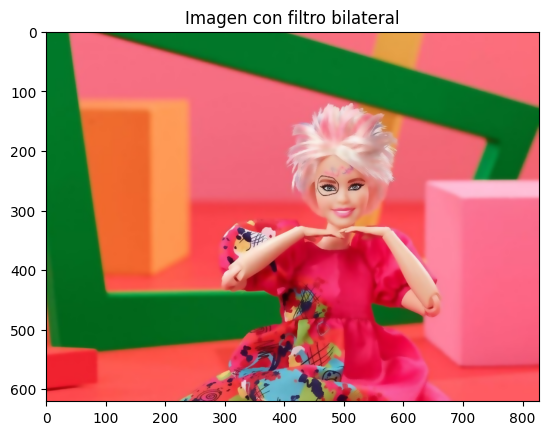

In [69]:
# Aplicar filtro bilateral
blurred_bilateral = cv2.bilateralFilter(bgr, 9, 75, 75)
blurred_bilateral_rgb = cv2.cvtColor(blurred_bilateral, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_bilateral_rgb)
plt.title('Imagen con filtro bilateral')
plt.show()

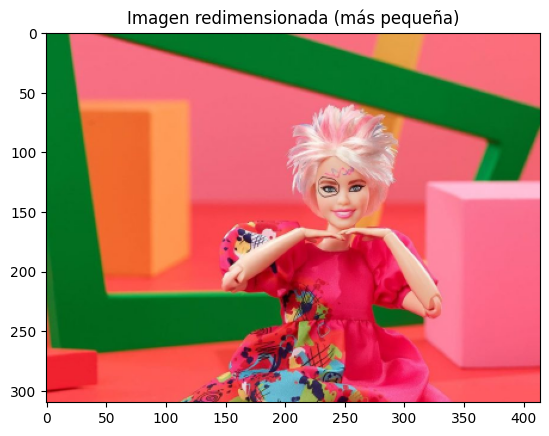

In [70]:
# Transformacion geometrica: Redimensionamiento (mas pequeña)
bgr_small = cv2.resize(bgr, (0, 0), fx=0.5, fy=0.5)
bgr_small_rgb = cv2.cvtColor(bgr_small, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_small_rgb)
plt.title('Imagen redimensionada (más pequeña)')
plt.show()

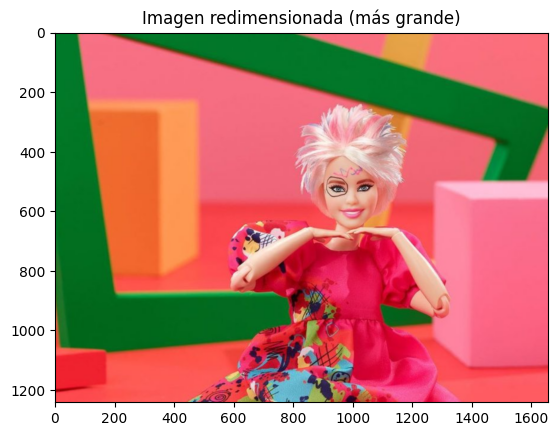

In [71]:
# Transformacion geometrica: Redimensionamiento (mas grande)
bgr_large = cv2.resize(bgr, (0, 0), fx=2, fy=2)
bgr_large_rgb = cv2.cvtColor(bgr_large, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_large_rgb)
plt.title('Imagen redimensionada (más grande)')
plt.show()

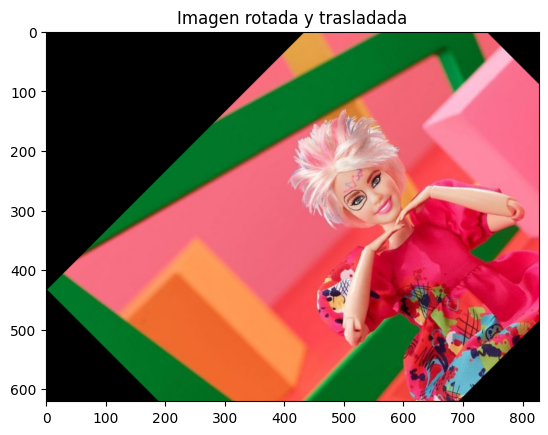

In [72]:
# Transformacion geometrica: Rotacion y translacion
(h, w) = bgr.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, 45, 1.0)
M[0, 2] += 100  # Desplazamiento en x
M[1, 2] += 50   # Desplazamiento en y
bgr_transformed = cv2.warpAffine(bgr, M, (w, h))
bgr_transformed_rgb = cv2.cvtColor(bgr_transformed, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_transformed_rgb)
plt.title('Imagen rotada y trasladada')
plt.show()

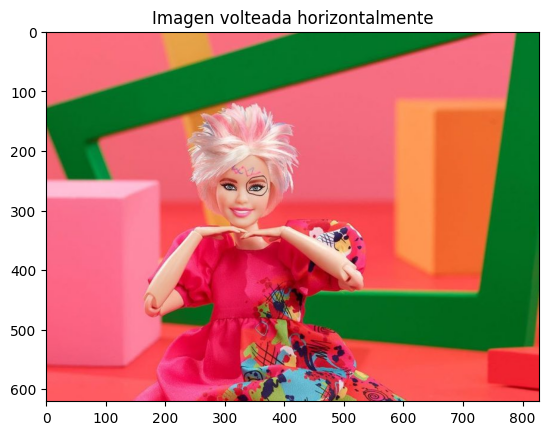

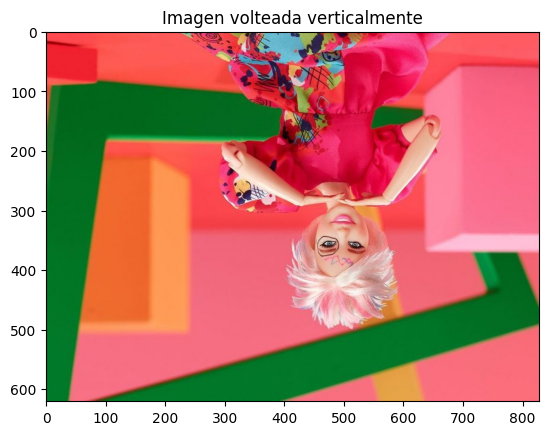

In [73]:
# Transformacion geometrica: Volteo horizontal y vertical
bgr_flipped_h = cv2.flip(bgr, 1)
bgr_flipped_h_rgb = cv2.cvtColor(bgr_flipped_h, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_h_rgb)
plt.title('Imagen volteada horizontalmente')
plt.show()

bgr_flipped_v = cv2.flip(bgr, 0)
bgr_flipped_v_rgb = cv2.cvtColor(bgr_flipped_v, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_v_rgb)
plt.title('Imagen volteada verticalmente')
plt.show()

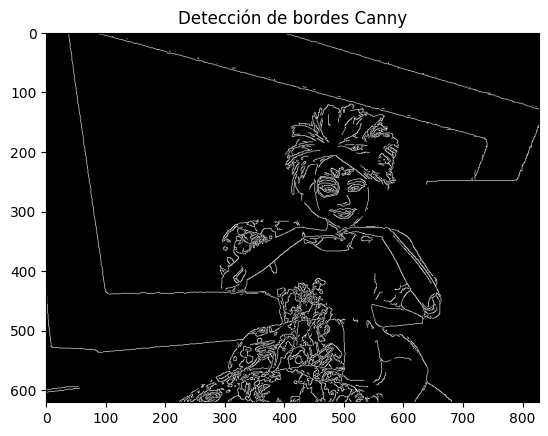

In [74]:
# Aplicar detencion de bordes Canny
edges = cv2.Canny(bgr, 100, 200)
plt.imshow(edges, cmap='gray')
plt.title('Detección de bordes Canny')
plt.show()

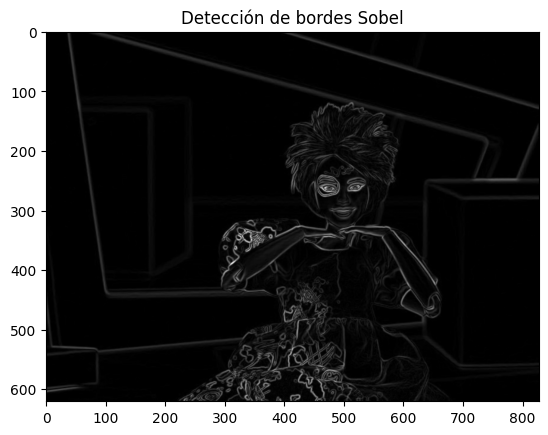

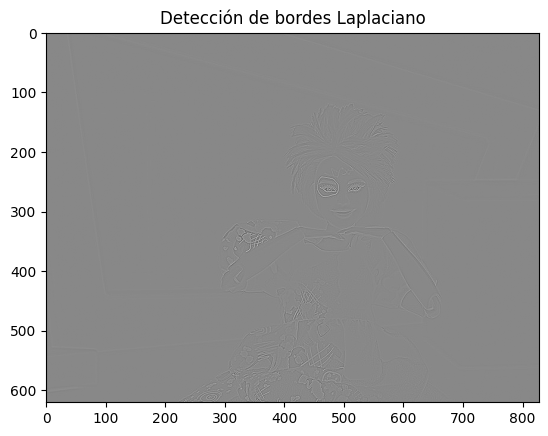

In [75]:
# Aplicar analisis de bordes Sobel y Laplaciano
sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
sobel_combined = cv2.magnitude(sobel_x, sobel_y)
plt.imshow(sobel_combined, cmap='gray')
plt.title('Detección de bordes Sobel')
plt.show()

laplacian = cv2.Laplacian(gray, cv2.CV_64F)
plt.imshow(laplacian, cmap='gray')
plt.title('Detección de bordes Laplaciano')
plt.show()

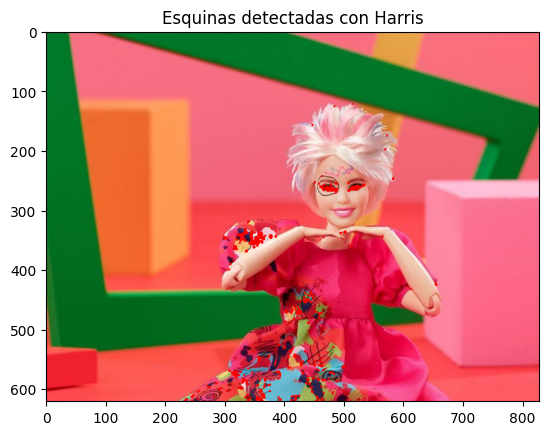

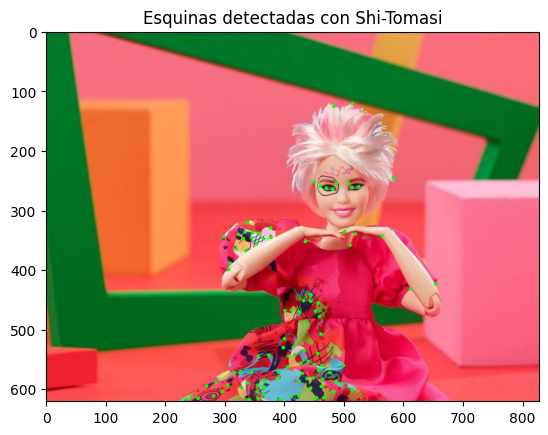

In [76]:
# Aplicar metodos de detencion de esquinas Harris y Shi-Tomasi
gray_float = np.float32(gray)
harris_corners = cv2.cornerHarris(gray_float, 2, 3, 0.04)
harris_corners = cv2.dilate(harris_corners, None)
bgr_harris = bgr.copy()
bgr_harris[harris_corners > 0.01 * harris_corners.max()] = [0, 0, 255]
bgr_harris_rgb = cv2.cvtColor(bgr_harris, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_harris_rgb)
plt.title('Esquinas detectadas con Harris')
plt.show()
shi_corners = cv2.goodFeaturesToTrack(gray, 100, 0.01, 10)
shi_corners = shi_corners.astype(int)
bgr_shi = bgr.copy()
for corner in shi_corners:
    x, y = corner.ravel()
    cv2.circle(bgr_shi, (x, y), 3, (0, 255, 0), -1)
bgr_shi_rgb = cv2.cvtColor(bgr_shi, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_shi_rgb)
plt.title('Esquinas detectadas con Shi-Tomasi')
plt.show()

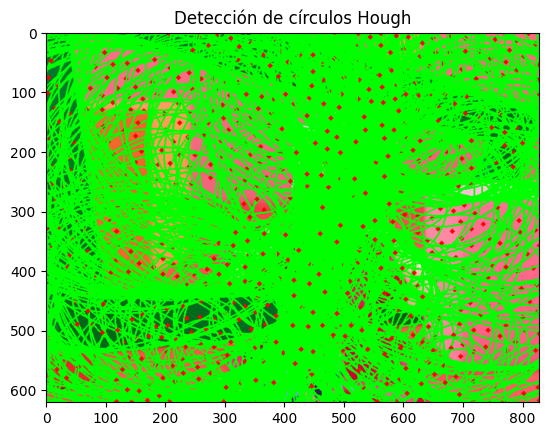

In [77]:
# Aplicar deteccion de formas HoughCircles
circles = cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT, dp=1, minDist=20,
                           param1=50, param2=30, minRadius=0, maxRadius=0)
bgr_circles = bgr.copy()
if circles is not None:
    circles = np.uint16(np.around(circles))
    for i in circles[0, :]:
        cv2.circle(bgr_circles, (i[0], i[1]), i[2], (0, 255, 0), 2)
        cv2.circle(bgr_circles, (i[0], i[1]), 2, (0, 0, 255), 3)
bgr_circles_rgb = cv2.cvtColor(bgr_circles, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_circles_rgb)
plt.title('Detección de círculos Hough')
plt.show()

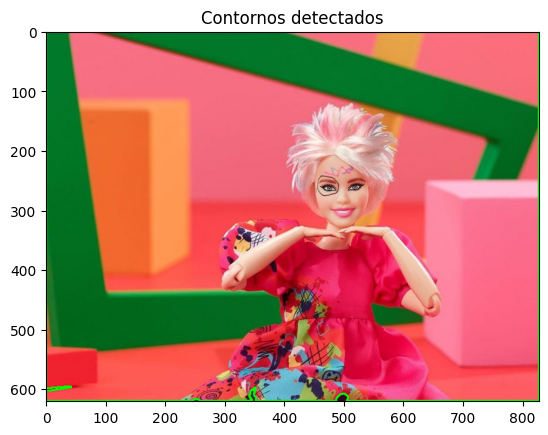

In [78]:
# Aplicar deccion de formas: contornos principales del objeto en la imagen
gray_blurred = cv2.GaussianBlur(gray, (5, 5), 0)
_, thresh = cv2.threshold(gray_blurred, 60, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
bgr_contours = bgr.copy()
cv2.drawContours(bgr_contours, contours, -1, (0, 255, 0), 2)
bgr_contours_rgb = cv2.cvtColor(bgr_contours, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_contours_rgb)
plt.title('Contornos detectados')
plt.show()

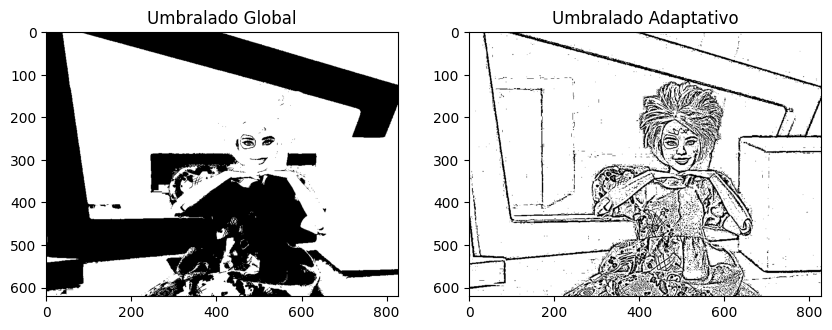

In [79]:
# Aplicar segmentacion de objeto: Umbralado (global y adaptativo)
_, global_thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 11, 2)
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(global_thresh, cmap='gray')
plt.title('Umbralado Global')
plt.subplot(1,2,2)
plt.imshow(adaptive_thresh, cmap='gray')
plt.title('Umbralado Adaptativo')
plt.show()

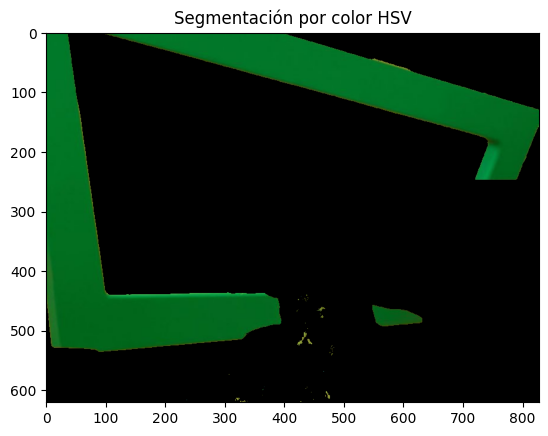

In [80]:
# Aplicar segmentacion de objeto: por color HSV
hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
lower_color = np.array([30, 150, 50])
upper_color = np.array([85, 255, 255])
mask = cv2.inRange(hsv, lower_color, upper_color)
result = cv2.bitwise_and(bgr, bgr, mask=mask)
result_rgb = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
plt.imshow(result_rgb)
plt.title('Segmentación por color HSV')
plt.show()

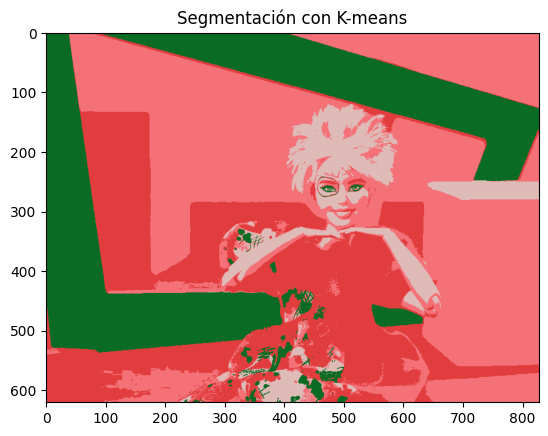

In [81]:
# Aplicar segmentacion de objeto: K-means clustering
Z = bgr.reshape((-1, 3))
Z = np.float32(Z)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
K = 4
_, labels, centers = cv2.kmeans(Z, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
centers = np.uint8(centers)
segmented_data = centers[labels.flatten()]
segmented_image = segmented_data.reshape((bgr.shape))
segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)
plt.imshow(segmented_image_rgb)
plt.title('Segmentación con K-means')
plt.show()

El tamaño de la imagen es: (225, 225, 3)


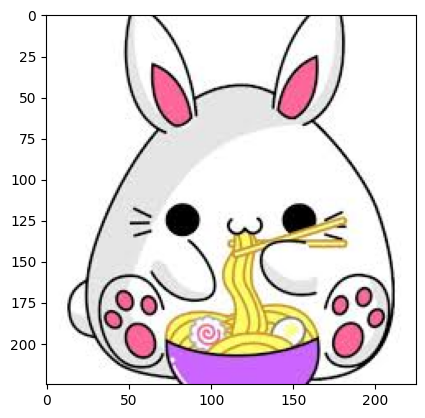

In [84]:
bgr = cv2.imread('imagen 4.jpeg')
print("El tamaño de la imagen es:", bgr.shape)
rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
plt.imshow(rgb)

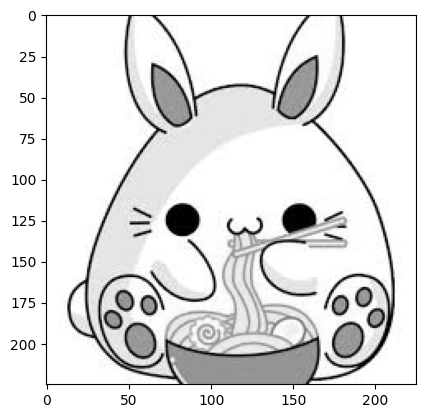

In [85]:
gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY)
plt.imshow(gray, cmap='gray')

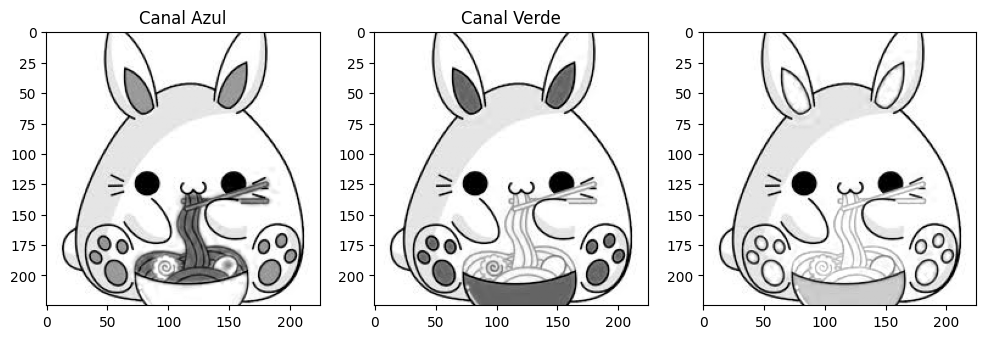

In [86]:
# Mostrar los componentes de color de la imagen
b, g, r = cv2.split(bgr)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(b, cmap='gray')
plt.title('Canal Azul')
plt.subplot(1,3,2)
plt.imshow(g, cmap='gray')
plt.title('Canal Verde')
plt.subplot(1,3,3)
plt.imshow(r, cmap='gray')

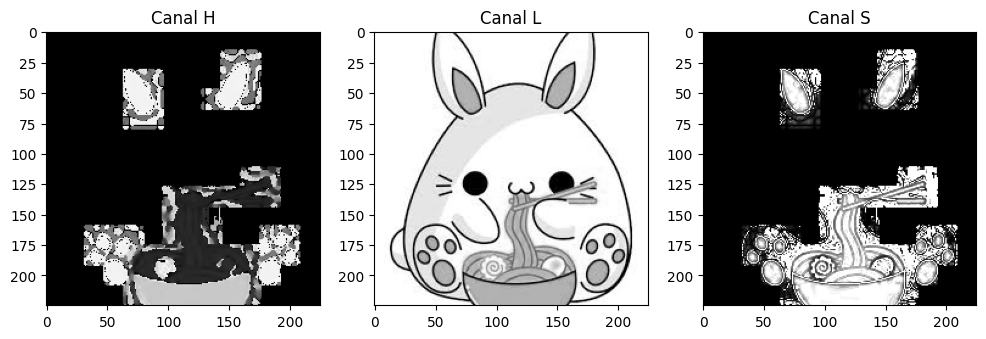

In [87]:
# Mostrar los componentes HLKS de la imagen
hls = cv2.cvtColor(bgr, cv2.COLOR_BGR2HLS)
h, l, s = cv2.split(hls)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(h, cmap='gray')
plt.title('Canal H')
plt.subplot(1,3,2)
plt.imshow(l, cmap='gray')
plt.title('Canal L')
plt.subplot(1,3,3)
plt.imshow(s, cmap='gray')
plt.title('Canal S')
plt.show()

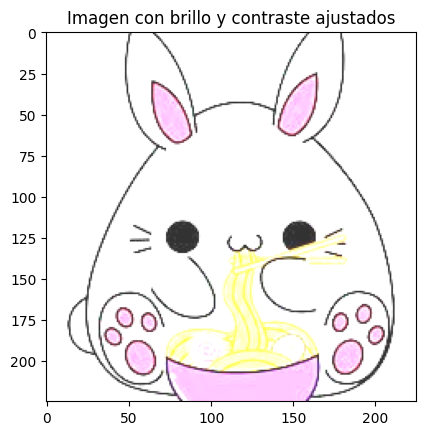

In [88]:
# Ajuste de brillo y contraste
alpha = 1.5  # Contraste
beta = 50    # Brillo
adjusted = cv2.convertScaleAbs(bgr, alpha=alpha, beta=beta)
adjusted_rgb = cv2.cvtColor(adjusted, cv2.COLOR_BGR2RGB)
plt.imshow(adjusted_rgb)
plt.title('Imagen con brillo y contraste ajustados')
plt.show()

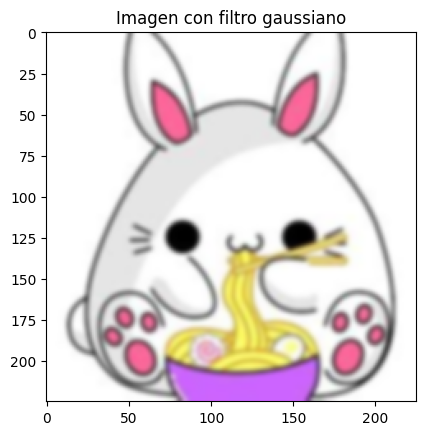

In [89]:
# Aplicar filtro gaussiano
blurred = cv2.GaussianBlur(bgr, (7, 7), 0)
blurred_rgb = cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_rgb)
plt.title('Imagen con filtro gaussiano')
plt.show()

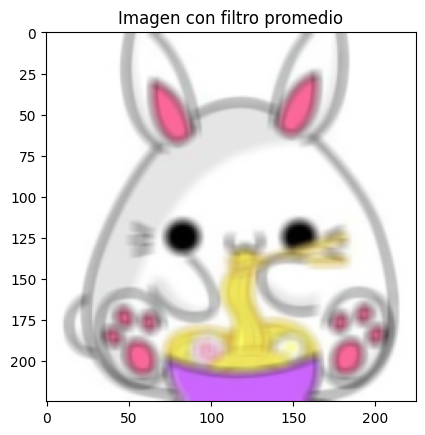

In [90]:
# Aplicar filtro promedio
kernel_size = (7, 7)
blurred_avg = cv2.blur(bgr, kernel_size)
blurred_avg_rgb = cv2.cvtColor(blurred_avg, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_avg_rgb)
plt.title('Imagen con filtro promedio')
plt.show()

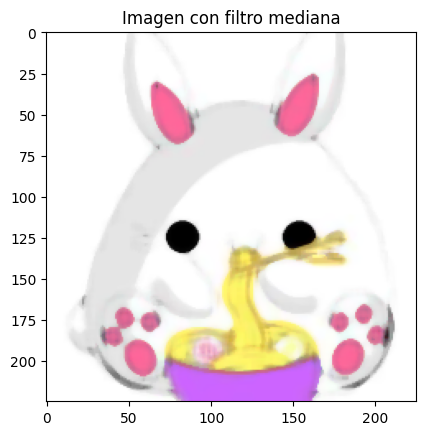

In [91]:
# Aplicar filtro mediana
blurred_median = cv2.medianBlur(bgr, 7)
blurred_median_rgb = cv2.cvtColor(blurred_median, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_median_rgb)
plt.title('Imagen con filtro mediana')
plt.show()

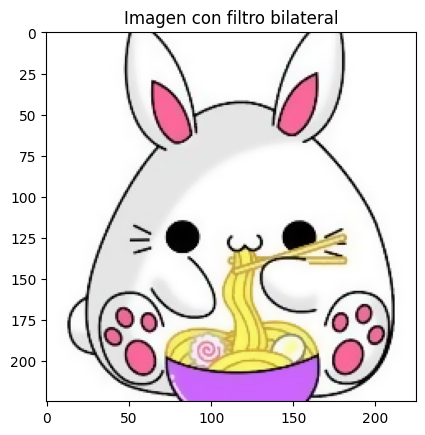

In [92]:
# Aplicar filtro bilateral
blurred_bilateral = cv2.bilateralFilter(bgr, 9, 75, 75)
blurred_bilateral_rgb = cv2.cvtColor(blurred_bilateral, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_bilateral_rgb)
plt.title('Imagen con filtro bilateral')
plt.show()

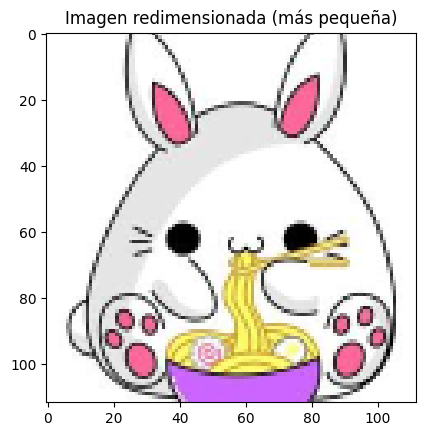

In [93]:
# Transformacion geometrica: Redimensionamiento (mas pequeña)
bgr_small = cv2.resize(bgr, (0, 0), fx=0.5, fy=0.5)
bgr_small_rgb = cv2.cvtColor(bgr_small, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_small_rgb)
plt.title('Imagen redimensionada (más pequeña)')
plt.show()

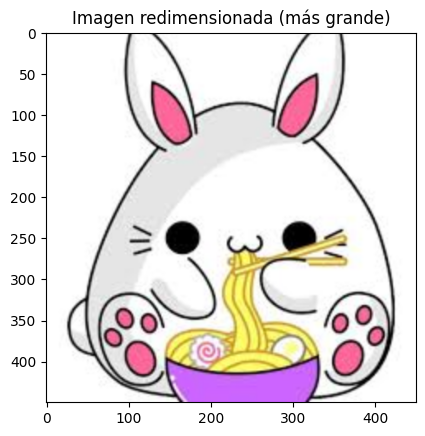

In [94]:
# Transformacion geometrica: Redimensionamiento (mas grande)
bgr_large = cv2.resize(bgr, (0, 0), fx=2, fy=2)
bgr_large_rgb = cv2.cvtColor(bgr_large, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_large_rgb)
plt.title('Imagen redimensionada (más grande)')
plt.show()

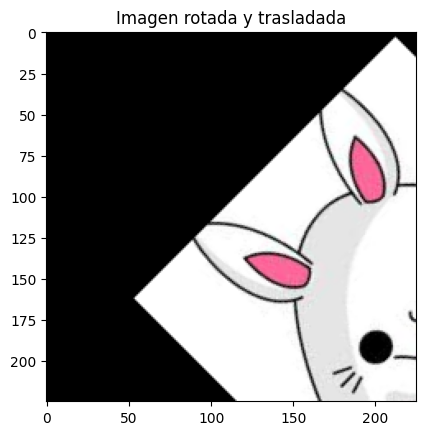

In [95]:
# Transformacion geometrica: Rotacion y translacion
(h, w) = bgr.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, 45, 1.0)
M[0, 2] += 100  # Desplazamiento en x
M[1, 2] += 50   # Desplazamiento en y
bgr_transformed = cv2.warpAffine(bgr, M, (w, h))
bgr_transformed_rgb = cv2.cvtColor(bgr_transformed, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_transformed_rgb)
plt.title('Imagen rotada y trasladada')
plt.show()

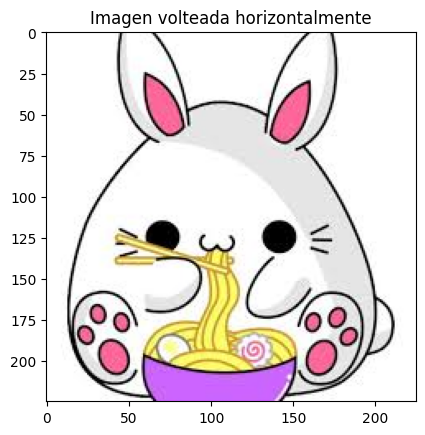

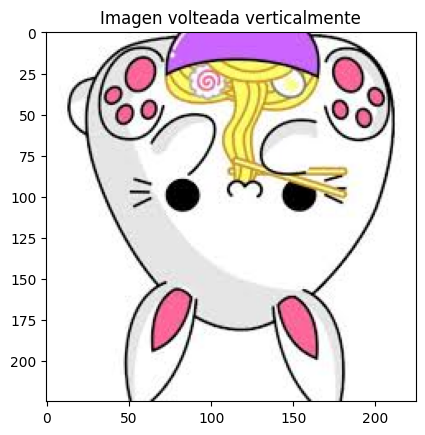

In [96]:
# Transformacion geometrica: Volteo horizontal y vertical
bgr_flipped_h = cv2.flip(bgr, 1)
bgr_flipped_h_rgb = cv2.cvtColor(bgr_flipped_h, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_h_rgb)
plt.title('Imagen volteada horizontalmente')
plt.show()

bgr_flipped_v = cv2.flip(bgr, 0)
bgr_flipped_v_rgb = cv2.cvtColor(bgr_flipped_v, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_v_rgb)
plt.title('Imagen volteada verticalmente')
plt.show()

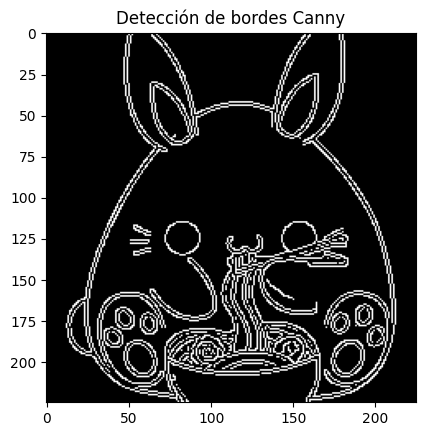

In [97]:
# Aplicar detencion de bordes Canny
edges = cv2.Canny(bgr, 100, 200)
plt.imshow(edges, cmap='gray')
plt.title('Detección de bordes Canny')
plt.show()

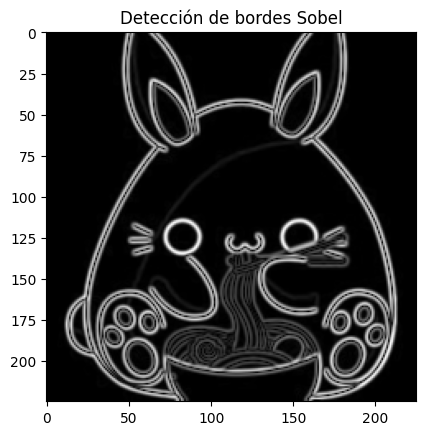

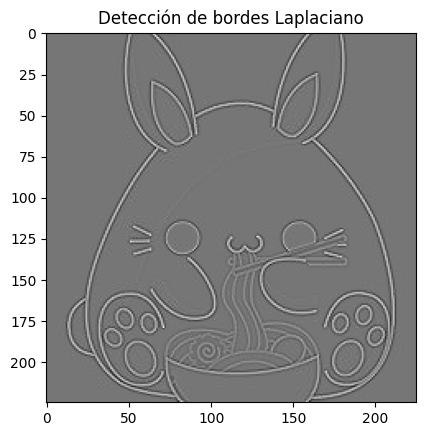

In [98]:
# Aplicar analisis de bordes Sobel y Laplaciano
sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
sobel_combined = cv2.magnitude(sobel_x, sobel_y)
plt.imshow(sobel_combined, cmap='gray')
plt.title('Detección de bordes Sobel')
plt.show()

laplacian = cv2.Laplacian(gray, cv2.CV_64F)
plt.imshow(laplacian, cmap='gray')
plt.title('Detección de bordes Laplaciano')
plt.show()

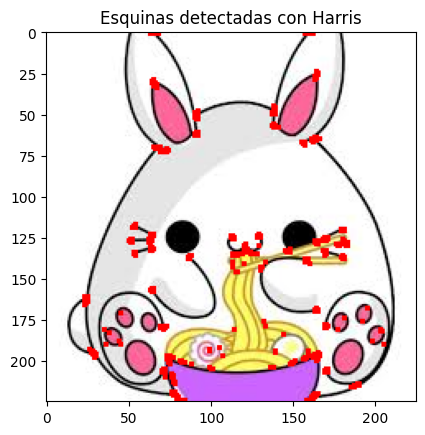

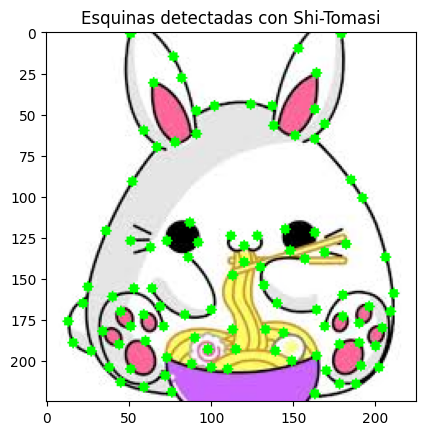

In [99]:
# Aplicar metodos de detencion de esquinas Harris y Shi-Tomasi
gray_float = np.float32(gray)
harris_corners = cv2.cornerHarris(gray_float, 2, 3, 0.04)
harris_corners = cv2.dilate(harris_corners, None)
bgr_harris = bgr.copy()
bgr_harris[harris_corners > 0.01 * harris_corners.max()] = [0, 0, 255]
bgr_harris_rgb = cv2.cvtColor(bgr_harris, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_harris_rgb)
plt.title('Esquinas detectadas con Harris')
plt.show()
shi_corners = cv2.goodFeaturesToTrack(gray, 100, 0.01, 10)
shi_corners = shi_corners.astype(int)
bgr_shi = bgr.copy()
for corner in shi_corners:
    x, y = corner.ravel()
    cv2.circle(bgr_shi, (x, y), 3, (0, 255, 0), -1)
bgr_shi_rgb = cv2.cvtColor(bgr_shi, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_shi_rgb)
plt.title('Esquinas detectadas con Shi-Tomasi')
plt.show()

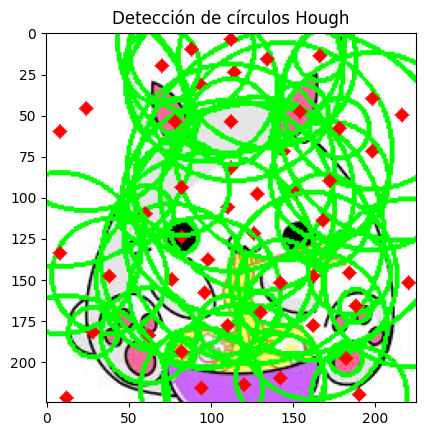

In [100]:
# Aplicar deteccion de formas HoughCircles
circles = cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT, dp=1, minDist=20,
                           param1=50, param2=30, minRadius=0, maxRadius=0)
bgr_circles = bgr.copy()
if circles is not None:
    circles = np.uint16(np.around(circles))
    for i in circles[0, :]:
        cv2.circle(bgr_circles, (i[0], i[1]), i[2], (0, 255, 0), 2)
        cv2.circle(bgr_circles, (i[0], i[1]), 2, (0, 0, 255), 3)
bgr_circles_rgb = cv2.cvtColor(bgr_circles, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_circles_rgb)
plt.title('Detección de círculos Hough')
plt.show()

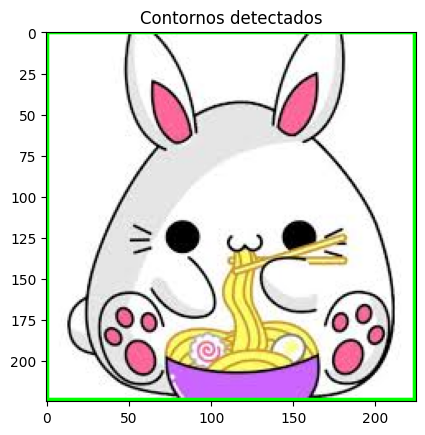

In [101]:
# Aplicar deccion de formas: contornos principales del objeto en la imagen
gray_blurred = cv2.GaussianBlur(gray, (5, 5), 0)
_, thresh = cv2.threshold(gray_blurred, 60, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
bgr_contours = bgr.copy()
cv2.drawContours(bgr_contours, contours, -1, (0, 255, 0), 2)
bgr_contours_rgb = cv2.cvtColor(bgr_contours, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_contours_rgb)
plt.title('Contornos detectados')
plt.show()

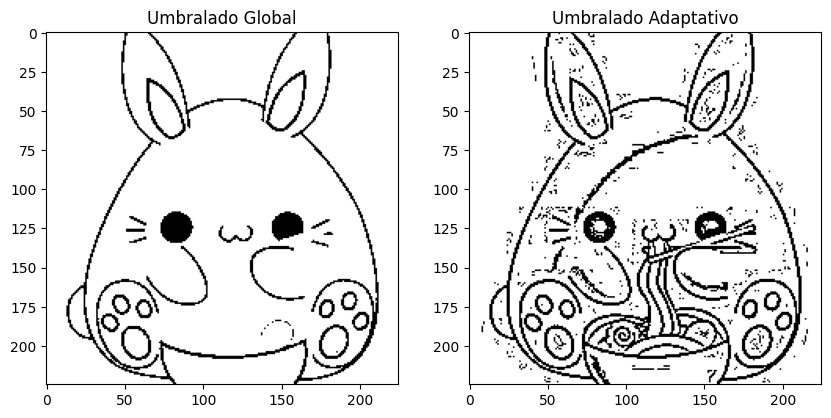

In [102]:
# Aplicar segmentacion de objeto: Umbralado (global y adaptativo)
_, global_thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 11, 2)
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(global_thresh, cmap='gray')
plt.title('Umbralado Global')
plt.subplot(1,2,2)
plt.imshow(adaptive_thresh, cmap='gray')
plt.title('Umbralado Adaptativo')
plt.show()

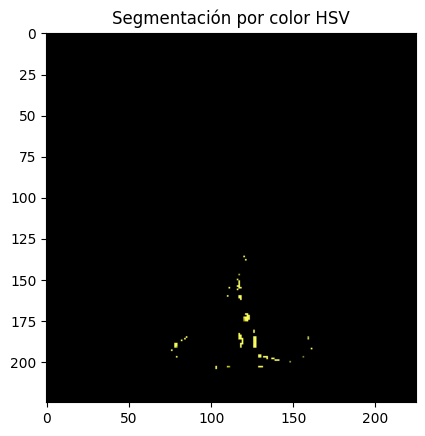

In [103]:
# Aplicar segmentacion de objeto: por color HSV
hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
lower_color = np.array([30, 150, 50])
upper_color = np.array([85, 255, 255])
mask = cv2.inRange(hsv, lower_color, upper_color)
result = cv2.bitwise_and(bgr, bgr, mask=mask)
result_rgb = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
plt.imshow(result_rgb)
plt.title('Segmentación por color HSV')
plt.show()

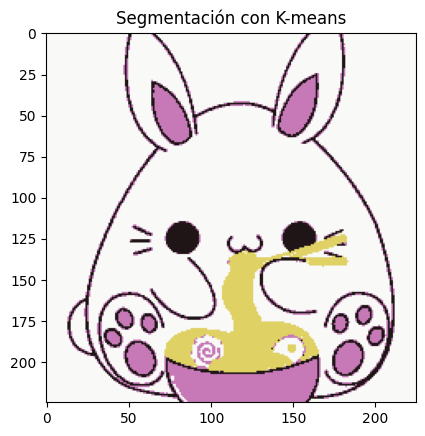

In [104]:
# Aplicar segmentacion de objeto: K-means clustering
Z = bgr.reshape((-1, 3))
Z = np.float32(Z)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
K = 4
_, labels, centers = cv2.kmeans(Z, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
centers = np.uint8(centers)
segmented_data = centers[labels.flatten()]
segmented_image = segmented_data.reshape((bgr.shape))
segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)
plt.imshow(segmented_image_rgb)
plt.title('Segmentación con K-means')
plt.show()

El tamaño de la imagen es: (222, 227, 3)


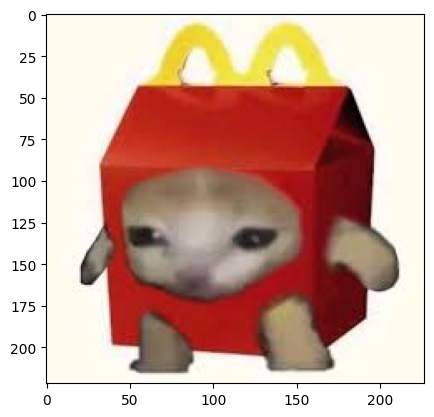

In [105]:
bgr = cv2.imread('imagen 5.jpeg')
print("El tamaño de la imagen es:", bgr.shape)
rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
plt.imshow(rgb)

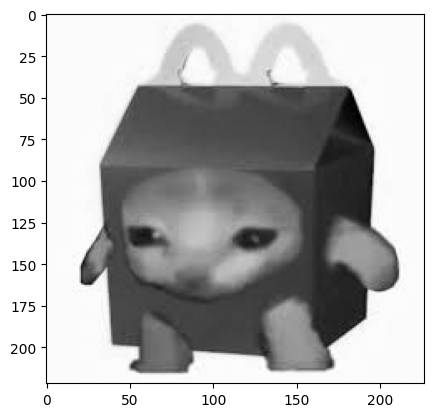

In [106]:
gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY)
plt.imshow(gray, cmap='gray')

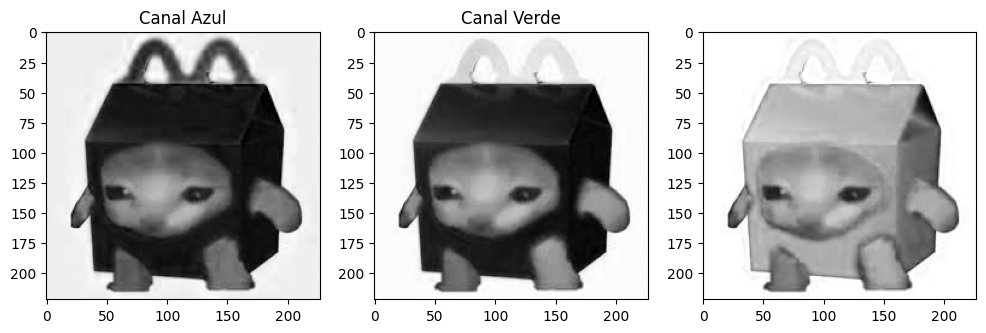

In [107]:
# Mostrar los componentes de color de la imagen
b, g, r = cv2.split(bgr)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(b, cmap='gray')
plt.title('Canal Azul')
plt.subplot(1,3,2)
plt.imshow(g, cmap='gray')
plt.title('Canal Verde')
plt.subplot(1,3,3)
plt.imshow(r, cmap='gray')

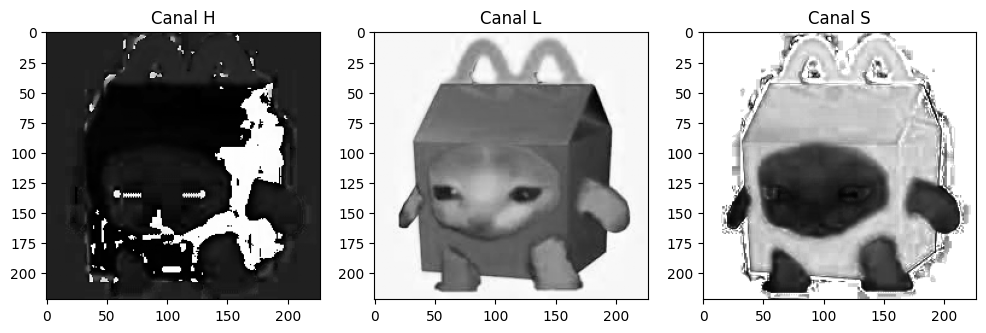

In [108]:
# Mostrar los componentes HLKS de la imagen
hls = cv2.cvtColor(bgr, cv2.COLOR_BGR2HLS)
h, l, s = cv2.split(hls)
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
plt.imshow(h, cmap='gray')
plt.title('Canal H')
plt.subplot(1,3,2)
plt.imshow(l, cmap='gray')
plt.title('Canal L')
plt.subplot(1,3,3)
plt.imshow(s, cmap='gray')
plt.title('Canal S')
plt.show()

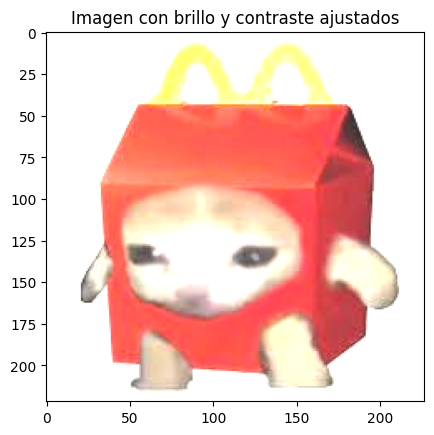

In [109]:
# Ajuste de brillo y contraste
alpha = 1.5  # Contraste
beta = 50    # Brillo
adjusted = cv2.convertScaleAbs(bgr, alpha=alpha, beta=beta)
adjusted_rgb = cv2.cvtColor(adjusted, cv2.COLOR_BGR2RGB)
plt.imshow(adjusted_rgb)
plt.title('Imagen con brillo y contraste ajustados')
plt.show()

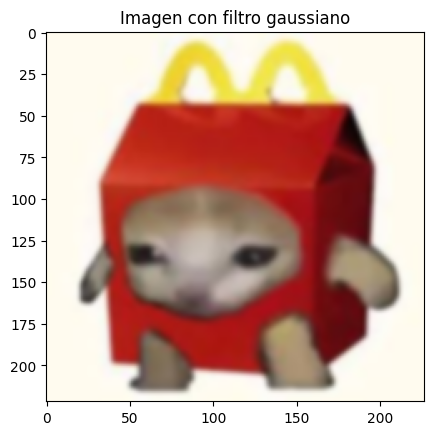

In [110]:
# Aplicar filtro gaussiano
blurred = cv2.GaussianBlur(bgr, (7, 7), 0)
blurred_rgb = cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_rgb)
plt.title('Imagen con filtro gaussiano')
plt.show()

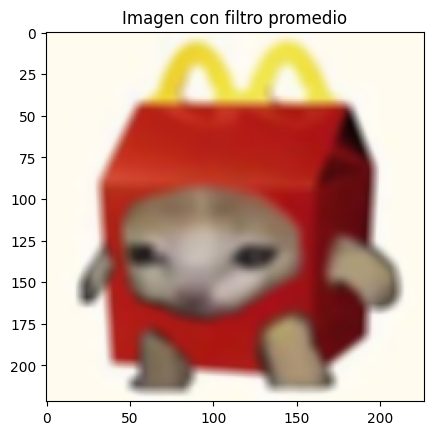

In [111]:
# Aplicar filtro promedio
kernel_size = (7, 7)
blurred_avg = cv2.blur(bgr, kernel_size)
blurred_avg_rgb = cv2.cvtColor(blurred_avg, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_avg_rgb)
plt.title('Imagen con filtro promedio')
plt.show()

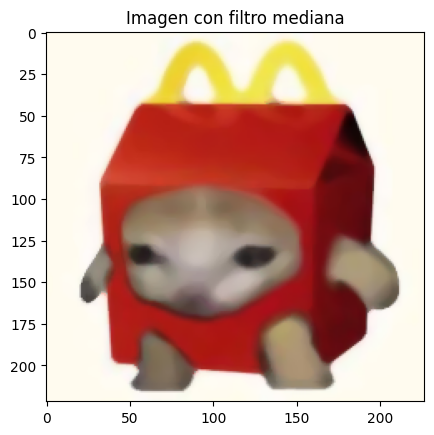

In [112]:
# Aplicar filtro mediana
blurred_median = cv2.medianBlur(bgr, 7)
blurred_median_rgb = cv2.cvtColor(blurred_median, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_median_rgb)
plt.title('Imagen con filtro mediana')
plt.show()

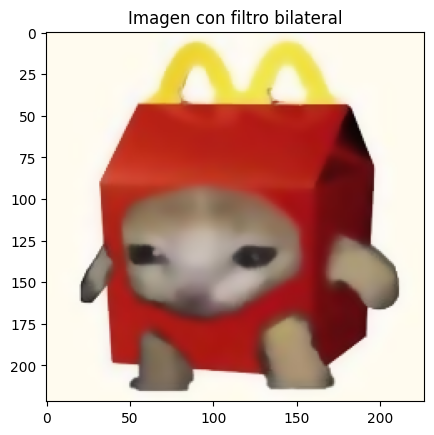

In [113]:
# Aplicar filtro bilateral
blurred_bilateral = cv2.bilateralFilter(bgr, 9, 75, 75)
blurred_bilateral_rgb = cv2.cvtColor(blurred_bilateral, cv2.COLOR_BGR2RGB)
plt.imshow(blurred_bilateral_rgb)
plt.title('Imagen con filtro bilateral')
plt.show()

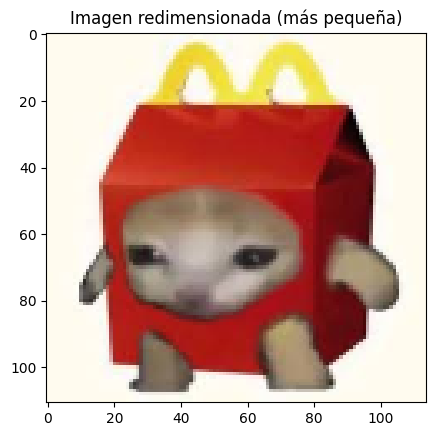

In [114]:
# Transformacion geometrica: Redimensionamiento (mas pequeña)
bgr_small = cv2.resize(bgr, (0, 0), fx=0.5, fy=0.5)
bgr_small_rgb = cv2.cvtColor(bgr_small, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_small_rgb)
plt.title('Imagen redimensionada (más pequeña)')
plt.show()

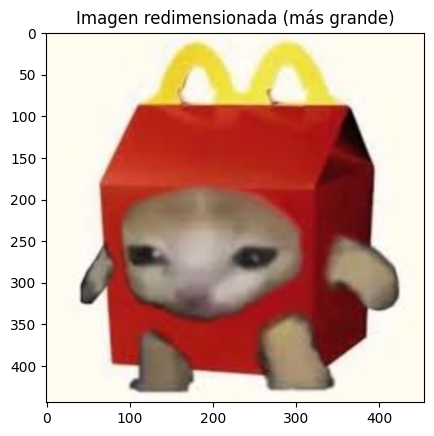

In [115]:
# Transformacion geometrica: Redimensionamiento (mas grande)
bgr_large = cv2.resize(bgr, (0, 0), fx=2, fy=2)
bgr_large_rgb = cv2.cvtColor(bgr_large, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_large_rgb)
plt.title('Imagen redimensionada (más grande)')
plt.show()

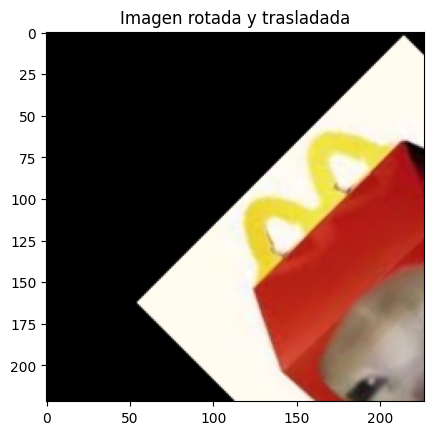

In [116]:
# Transformacion geometrica: Rotacion y translacion
(h, w) = bgr.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, 45, 1.0)
M[0, 2] += 100  # Desplazamiento en x
M[1, 2] += 50   # Desplazamiento en y
bgr_transformed = cv2.warpAffine(bgr, M, (w, h))
bgr_transformed_rgb = cv2.cvtColor(bgr_transformed, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_transformed_rgb)
plt.title('Imagen rotada y trasladada')
plt.show()

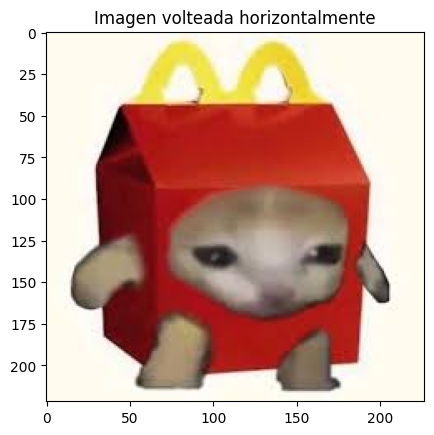

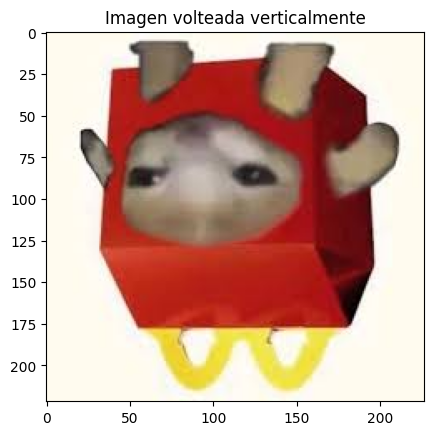

In [117]:
# Transformacion geometrica: Volteo horizontal y vertical
bgr_flipped_h = cv2.flip(bgr, 1)
bgr_flipped_h_rgb = cv2.cvtColor(bgr_flipped_h, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_h_rgb)
plt.title('Imagen volteada horizontalmente')
plt.show()

bgr_flipped_v = cv2.flip(bgr, 0)
bgr_flipped_v_rgb = cv2.cvtColor(bgr_flipped_v, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_flipped_v_rgb)
plt.title('Imagen volteada verticalmente')
plt.show()

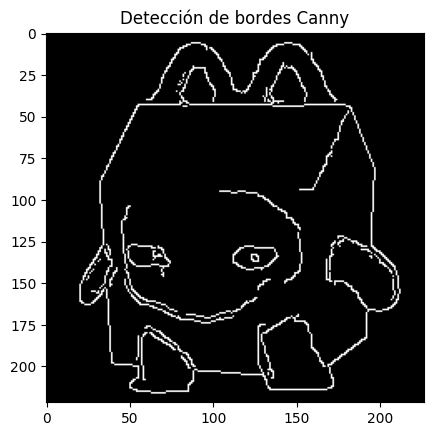

In [118]:
# Aplicar detencion de bordes Canny
edges = cv2.Canny(bgr, 100, 200)
plt.imshow(edges, cmap='gray')
plt.title('Detección de bordes Canny')
plt.show()

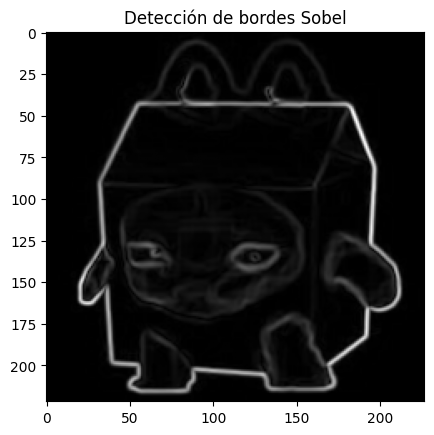

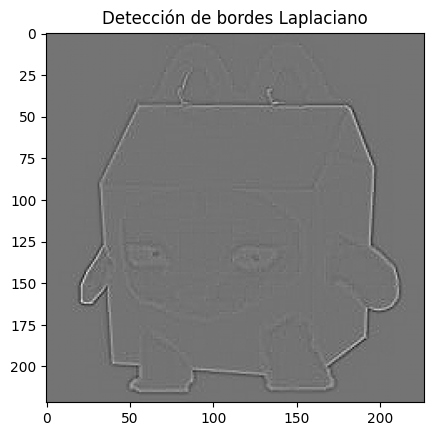

In [119]:
# Aplicar analisis de bordes Sobel y Laplaciano
sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
sobel_combined = cv2.magnitude(sobel_x, sobel_y)
plt.imshow(sobel_combined, cmap='gray')
plt.title('Detección de bordes Sobel')
plt.show()

laplacian = cv2.Laplacian(gray, cv2.CV_64F)
plt.imshow(laplacian, cmap='gray')
plt.title('Detección de bordes Laplaciano')
plt.show()

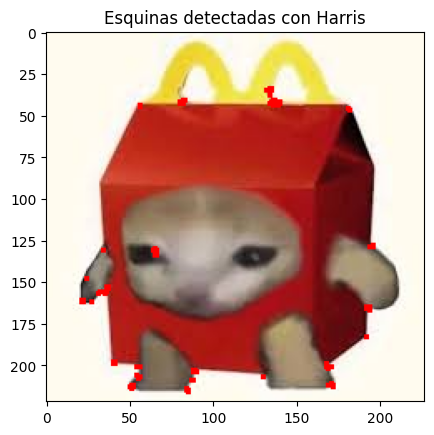

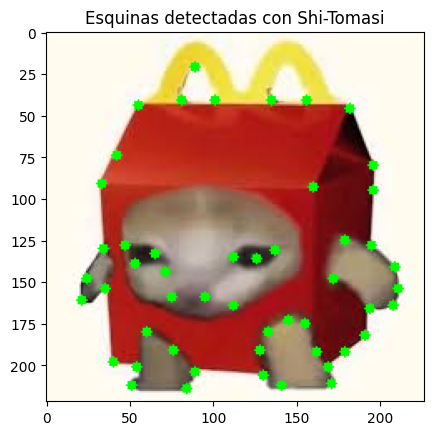

In [120]:
# Aplicar metodos de detencion de esquinas Harris y Shi-Tomasi
gray_float = np.float32(gray)
harris_corners = cv2.cornerHarris(gray_float, 2, 3, 0.04)
harris_corners = cv2.dilate(harris_corners, None)
bgr_harris = bgr.copy()
bgr_harris[harris_corners > 0.01 * harris_corners.max()] = [0, 0, 255]
bgr_harris_rgb = cv2.cvtColor(bgr_harris, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_harris_rgb)
plt.title('Esquinas detectadas con Harris')
plt.show()
shi_corners = cv2.goodFeaturesToTrack(gray, 100, 0.01, 10)
shi_corners = shi_corners.astype(int)
bgr_shi = bgr.copy()
for corner in shi_corners:
    x, y = corner.ravel()
    cv2.circle(bgr_shi, (x, y), 3, (0, 255, 0), -1)
bgr_shi_rgb = cv2.cvtColor(bgr_shi, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_shi_rgb)
plt.title('Esquinas detectadas con Shi-Tomasi')
plt.show()

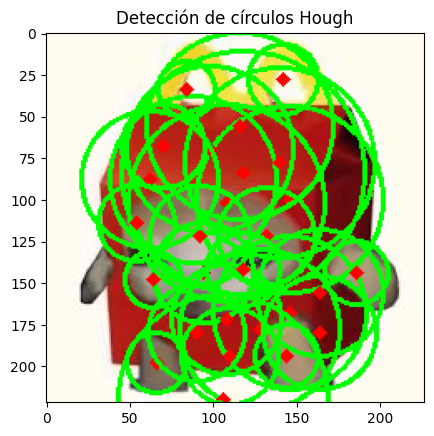

In [121]:
# Aplicar deteccion de formas HoughCircles
circles = cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT, dp=1, minDist=20,
                           param1=50, param2=30, minRadius=0, maxRadius=0)
bgr_circles = bgr.copy()
if circles is not None:
    circles = np.uint16(np.around(circles))
    for i in circles[0, :]:
        cv2.circle(bgr_circles, (i[0], i[1]), i[2], (0, 255, 0), 2)
        cv2.circle(bgr_circles, (i[0], i[1]), 2, (0, 0, 255), 3)
bgr_circles_rgb = cv2.cvtColor(bgr_circles, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_circles_rgb)
plt.title('Detección de círculos Hough')
plt.show()

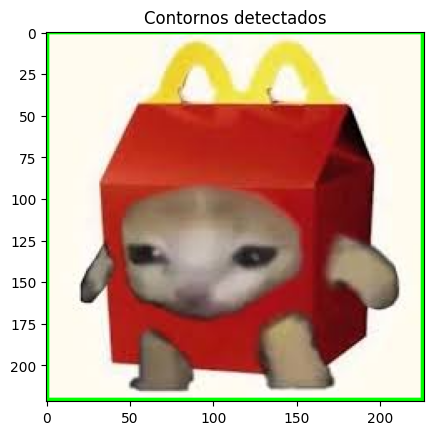

In [122]:
# Aplicar deccion de formas: contornos principales del objeto en la imagen
gray_blurred = cv2.GaussianBlur(gray, (5, 5), 0)
_, thresh = cv2.threshold(gray_blurred, 60, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
bgr_contours = bgr.copy()
cv2.drawContours(bgr_contours, contours, -1, (0, 255, 0), 2)
bgr_contours_rgb = cv2.cvtColor(bgr_contours, cv2.COLOR_BGR2RGB)
plt.imshow(bgr_contours_rgb)
plt.title('Contornos detectados')
plt.show()

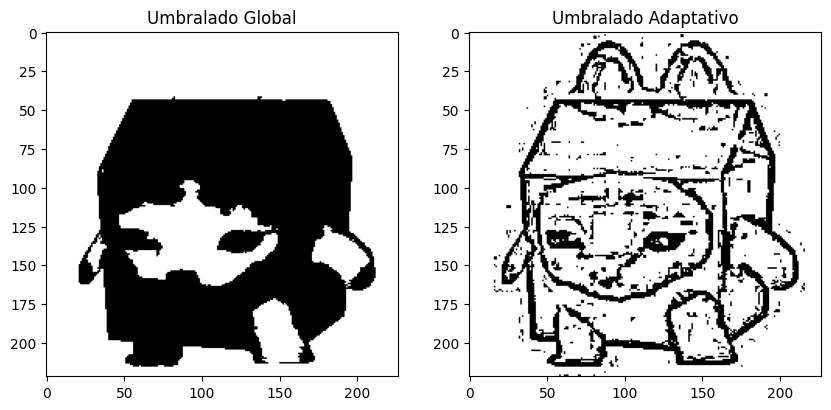

In [123]:
# Aplicar segmentacion de objeto: Umbralado (global y adaptativo)
_, global_thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 11, 2)
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(global_thresh, cmap='gray')
plt.title('Umbralado Global')
plt.subplot(1,2,2)
plt.imshow(adaptive_thresh, cmap='gray')
plt.title('Umbralado Adaptativo')
plt.show()

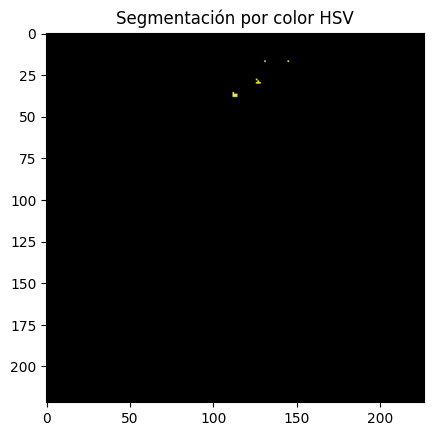

In [124]:
# Aplicar segmentacion de objeto: por color HSV
hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
lower_color = np.array([30, 150, 50])
upper_color = np.array([85, 255, 255])
mask = cv2.inRange(hsv, lower_color, upper_color)
result = cv2.bitwise_and(bgr, bgr, mask=mask)
result_rgb = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
plt.imshow(result_rgb)
plt.title('Segmentación por color HSV')
plt.show()

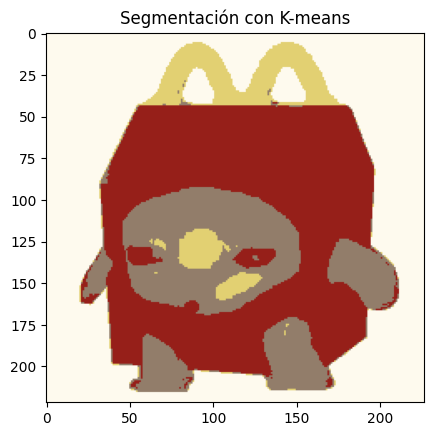

In [125]:
# Aplicar segmentacion de objeto: K-means clustering
Z = bgr.reshape((-1, 3))
Z = np.float32(Z)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
K = 4
_, labels, centers = cv2.kmeans(Z, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
centers = np.uint8(centers)
segmented_data = centers[labels.flatten()]
segmented_image = segmented_data.reshape((bgr.shape))
segmented_image_rgb = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB)
plt.imshow(segmented_image_rgb)
plt.title('Segmentación con K-means')
plt.show()